# Introduction

The project is the final project for the AI saturday cohort 6. We chose the dataset"Default of Credit Card Clients" from Kaggle  repository for our final project and would preprocess the data and use some classification algorithms to predict whether a client would default or not . This goal of this notebook is to use different algorithms to build the best model to predict the likelihood of a customer defaulting on their credit card loan.This project was motivated by the high default rate in recent years as shown in this cbn survey https://www.cbn.gov.ng/out/2020/std/q1%202020%20ccs%20report.pdf 
 
## Overview:

We've used our skills like data cleaning, data analysis, data visualization and machine learning. We carried out a research and built several ML models to predict defaulters of credit card loan repayments and compared the performance of the models.

This notebook consisits of the following parts:

1) Exploratory Data Analysis

2) Data cleaning and further exploration

3) Building a base model

4) Feature Engineering

5) Building ML model using various algorithms and comparing them

6) Conclusion

 
## About the dataset:
This dataset contains information on default payments, demographic factors, credit data, history of payment, and bill statements of credit card clients in Taiwan from April 2005 to September 2005. 

## Features:
There are 25 features:

* ID: ID of each client
* LIMIT_BAL: Amount of given credit in NT dollars (includes individual and family/supplementary credit
* SEX: Gender (1=male, 2=female)
* EDUCATION: (1=graduate school, 2=university, 3=high school, 4=others, 5=unknown, 6=unknown)
* MARRIAGE: Marital status (1=married, 2=single, 3=others)
* AGE: Age in years
* PAY_0: Repayment status in September, 2005 (-1=pay duly, 1=payment delay for one month, 2=payment delay for two months, ... 8=payment delay for eight months, 9=payment delay for nine months and above)
* PAY_2: Repayment status in August, 2005 (scale same as above)
* PAY_3: Repayment status in July, 2005 (scale same as above)
* PAY_4: Repayment status in June, 2005 (scale same as above)
* PAY_5: Repayment status in May, 2005 (scale same as above)
* PAY_6: Repayment status in April, 2005 (scale same as above)
* BILL_AMT1: Amount of bill statement in September, 2005 (NT dollar)
* BILL_AMT2: Amount of bill statement in August, 2005 (NT dollar)
* BILL_AMT3: Amount of bill statement in July, 2005 (NT dollar)
* BILL_AMT4: Amount of bill statement in June, 2005 (NT dollar)
* BILL_AMT5: Amount of bill statement in May, 2005 (NT dollar)
* BILL_AMT6: Amount of bill statement in April, 2005 (NT dollar)
* PAY_AMT1: Amount of previous payment in September, 2005 (NT dollar)
* PAY_AMT2: Amount of previous payment in August, 2005 (NT dollar)
* PAY_AMT3: Amount of previous payment in July, 2005 (NT dollar)
* PAY_AMT4: Amount of previous payment in June, 2005 (NT dollar)
* PAY_AMT5: Amount of previous payment in May, 2005 (NT dollar)
* PAY_AMT6: Amount of previous payment in April, 2005 (NT dollar)
* default.payment.next.month: Default payment (1=yes, 0=no)




# Importation of Libraries

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import cross_val_score
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from xgboost import XGBClassifier
from catboost import CatBoostClassifier
from lightgbm import LGBMClassifier
from sklearn.svm import SVC
import plotly.graph_objs as go
from plotly.subplots import make_subplots
import scorecardpy as sc
import plotly.io as pio
pio.templates.default = "plotly_dark"

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler
from lightgbm import LGBMClassifier
from catboost import CatBoostClassifier
from scipy.stats import uniform as sp_uniform
from sklearn.metrics import make_scorer, cohen_kappa_score, accuracy_score
import scipy
QUADRATIC_WEIGHT_SCORER = make_scorer(cohen_kappa_score, weights='quadratic')


%matplotlib inline
pd.set_option('display.max_columns',None)
sns.set(style="darkgrid", palette="pastel", color_codes=True)
sns.set_context('paper')

import plotly.graph_objs as go
from plotly.subplots import make_subplots

from sklearn.utils import resample 
from imblearn.over_sampling import SMOTE
from sklearn.feature_selection import RFE,SelectFromModel
from sklearn.model_selection import KFold,GridSearchCV,RandomizedSearchCV
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline 
from sklearn.naive_bayes import GaussianNB
from scipy.stats import randint as sp_randint
from sklearn.ensemble import RandomForestClassifier ,ExtraTreesClassifier, AdaBoostClassifier,GradientBoostingClassifier
from sklearn.model_selection import RepeatedStratifiedKFold
from sklearn.feature_selection import RFECV
from sklearn.metrics import classification_report,confusion_matrix,f1_score,roc_auc_score,roc_curve,accuracy_score
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
import plotly.figure_factory as ff 

import warnings
warnings.filterwarnings("ignore")

import random
random.seed(10)


# Reading the csv file and dropping the ID feature

In [2]:
df = pd.read_csv('C:/Users/MOFEOLUWA/Desktop/UCI_Credit_Card.csv')
df = df.drop('ID', axis=1)

# Exploratory data analysis

In [3]:
# see the first five rows
df.head()

,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,PAY_5,PAY_6,BILL_AMT1,BILL_AMT2,BILL_AMT3,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default.payment.next.month
0,20000.0,2,2,1,24,2,2,-1,-1,-2,-2,3913.0,3102.0,689.0,0.0,0.0,0.0,0.0,689.0,0.0,0.0,0.0,0.0,1
1,120000.0,2,2,2,26,-1,2,0,0,0,2,2682.0,1725.0,2682.0,3272.0,3455.0,3261.0,0.0,1000.0,1000.0,1000.0,0.0,2000.0,1
2,90000.0,2,2,2,34,0,0,0,0,0,0,29239.0,14027.0,13559.0,14331.0,14948.0,15549.0,1518.0,1500.0,1000.0,1000.0,1000.0,5000.0,0
3,50000.0,2,2,1,37,0,0,0,0,0,0,46990.0,48233.0,49291.0,28314.0,28959.0,29547.0,2000.0,2019.0,1200.0,1100.0,1069.0,1000.0,0
4,50000.0,1,2,1,57,-1,0,-1,0,0,0,8617.0,5670.0,35835.0,20940.0,19146.0,19131.0,2000.0,36681.0,10000.0,9000.0,689.0,679.0,0


In [4]:
# As the first step, find out if there are missing or anomalous data.
df.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 30000 entries, 0 to 29999
Data columns (total 24 columns):
LIMIT_BAL                     30000 non-null float64
SEX                           30000 non-null int64
EDUCATION                     30000 non-null int64
MARRIAGE                      30000 non-null int64
AGE                           30000 non-null int64
PAY_0                         30000 non-null int64
PAY_2                         30000 non-null int64
PAY_3                         30000 non-null int64
PAY_4                         30000 non-null int64
PAY_5                         30000 non-null int64
PAY_6                         30000 non-null int64
BILL_AMT1                     30000 non-null float64
BILL_AMT2                     30000 non-null float64
BILL_AMT3                     30000 non-null float64
BILL_AMT4                     30000 non-null float64
BILL_AMT5                     30000 non-null float64
BILL_AMT6                     30000 non-null float64
PAY_AMT1  

In [5]:
# Let's rename the target column to "default" and payment status "PAY_0" to "PAY_1" to make it consecutive

df = df.rename(columns={'default.payment.next.month': 'default', 
                        'PAY_0': 'PAY_1'})

Text(0, 0.5, 'Number')

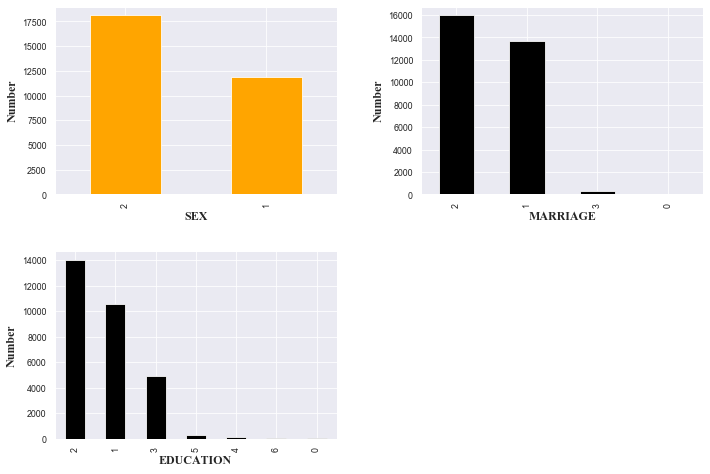

In [6]:
# Visualization of the Categorical features (Marriage, Sex, Education)


plt.subplots_adjust(left = 0, bottom = 0, right = 1.5, top = 1.5, wspace = 0.3, hspace = 0.3)
font = {'family' : 'Times New Roman', 'weight' : 'normal', 'size' : 12}

plt.subplot(2, 2, 1)
df.SEX.value_counts().plot(kind = 'bar', color='orange',alpha=1.0)
plt.xlabel("SEX", font)
plt.ylabel("Number", font)

plt.subplot(2, 2, 2)
df.MARRIAGE.value_counts().plot(kind = 'bar',color='black',alpha=1.0)
plt.xlabel("MARRIAGE", font)
plt.ylabel("Number", font)

plt.subplot(2, 2, 3)
df.EDUCATION.value_counts().plot(kind = 'bar',color='black',alpha=1.0)
plt.xlabel("EDUCATION", font)
plt.ylabel("Number", font)

1.) Marriage has label 0, which is undocumented

2.) It seems that there are more number of female customers

3.) Education has label 0 ,label 5 & label 6, which are undocumented. Also most of the customers are well educated!

NEXT

Visualization of the Numerical variables: (Bill amount,Previous payment,Previous payment status,Age,Amount given in credit)

we'll be using plotly for better visualization

In [7]:
#  bill amount

bills = df[['BILL_AMT1','BILL_AMT2', 'BILL_AMT3', 'BILL_AMT4', 'BILL_AMT5', 'BILL_AMT6']]

fig = make_subplots(rows= 3, cols=2,subplot_titles=bills.columns.to_list())  

fig.add_trace(go.Histogram(x= df["BILL_AMT1"],name='BILL_AMT1'),row = 1, col = 1)
fig.add_trace(go.Histogram(x= df["BILL_AMT2"],name='BILL_AMT2'),row = 2, col = 2)
fig.add_trace(go.Histogram(x= df["BILL_AMT3"],name='BILL_AMT3'),row = 3, col = 1)
fig.add_trace(go.Histogram(x= df["BILL_AMT4"],name='BILL_AMT4'),row = 1, col = 2)
fig.add_trace(go.Histogram(x= df["BILL_AMT5"],name='BILL_AMT5'),row = 2, col = 1)
fig.add_trace(go.Histogram(x= df["BILL_AMT6"],name='BILL_AMT6'),row = 3, col = 2)


fig.update_layout(height=600, width=800, title_text="Histogram Subplots of Bill Amount")
fig.show()

In [8]:
# pay amount (previous payment)

pay = df[['PAY_AMT1','PAY_AMT2', 'PAY_AMT3', 'PAY_AMT4', 'PAY_AMT5', 'PAY_AMT6']]

fig = make_subplots(rows= 3, cols=2,subplot_titles=pay.columns.to_list())  

fig.add_trace(go.Histogram(x= df["PAY_AMT1"],name='PAY_AMT1'),row = 1, col = 1)
fig.add_trace(go.Histogram(x= df["PAY_AMT2"],name='PAY_AMT2'),row = 2, col = 2)
fig.add_trace(go.Histogram(x= df["PAY_AMT3"],name='PAY_AMT3'),row = 3, col = 1)
fig.add_trace(go.Histogram(x= df["PAY_AMT4"],name='PAY_AMT4'),row = 1, col = 2)
fig.add_trace(go.Histogram(x= df["PAY_AMT5"],name='PAY_AMT5'),row = 2, col = 1)
fig.add_trace(go.Histogram(x= df["PAY_AMT6"],name='PAY_AMT6'),row = 3, col = 2)


fig.update_layout(height=600, width=800, title_text="Histogram Subplots of Amount of Previous Payment")
fig.show()

In [9]:
# previous payment status


pay_s = df[['PAY_1','PAY_2', 'PAY_3', 'PAY_4', 'PAY_5', 'PAY_6']]
df['PAY_1'].value_counts().index.to_list().sort()

fig = make_subplots(rows= 3, cols=2,subplot_titles=pay_s.columns.to_list())  

fig.add_trace(go.Histogram(x= df["PAY_1"],name='PAY_1'),row = 1, col = 1)
fig.add_trace(go.Histogram(x= df["PAY_2"],name='PAY_2'),row = 2, col = 2)
fig.add_trace(go.Histogram(x= df["PAY_3"],name='PAY_3'),row = 3, col = 1)
fig.add_trace(go.Histogram(x= df["PAY_4"],name='PAY_4'),row = 1, col = 2)
fig.add_trace(go.Histogram(x= df["PAY_5"],name='PAY_5'),row = 2, col = 1)
fig.add_trace(go.Histogram(x= df["PAY_6"],name='PAY_6'),row = 3, col = 2)


fig.update_layout(bargap=0.2,height=600, width=800, title_text="Histogram Subplots of Previous Payment Status")
fig.show()


From the above;

There are a lot of customers who pay The previous amount duly but there are only some of them who pay late

In [10]:
# Age

fig =  go.Figure(data=[go.Histogram(x= df["AGE"])])
fig.show()

Looking at the distribution, it's clear that there are more people who are aged between 20-30 and it goes on decreasing after 30. 

It is also a bit right skewed

In [11]:
# Amount given in credit


fig =  go.Figure(data=[go.Histogram(x= df["LIMIT_BAL"])])
fig.show()

More of the people have taken credit between 10k to 400k.

In [12]:
# Target column (Default)


target_count = df['default'].value_counts().reset_index().rename(columns={'index':'index','default':'count'})
fig = go.Figure(go.Bar(
    x = target_count['index'],y = target_count['count'],text=target_count['count'],marker={'color': target_count['count']}
    ,textposition = "outside"))
fig.update_layout(title_text='Count plot of defaulter',xaxis_title="Status of Defaulting",yaxis_title="Number of count")
fig.show()

The data has a large imbalance with respect of the target value (default).

This would be addressed later

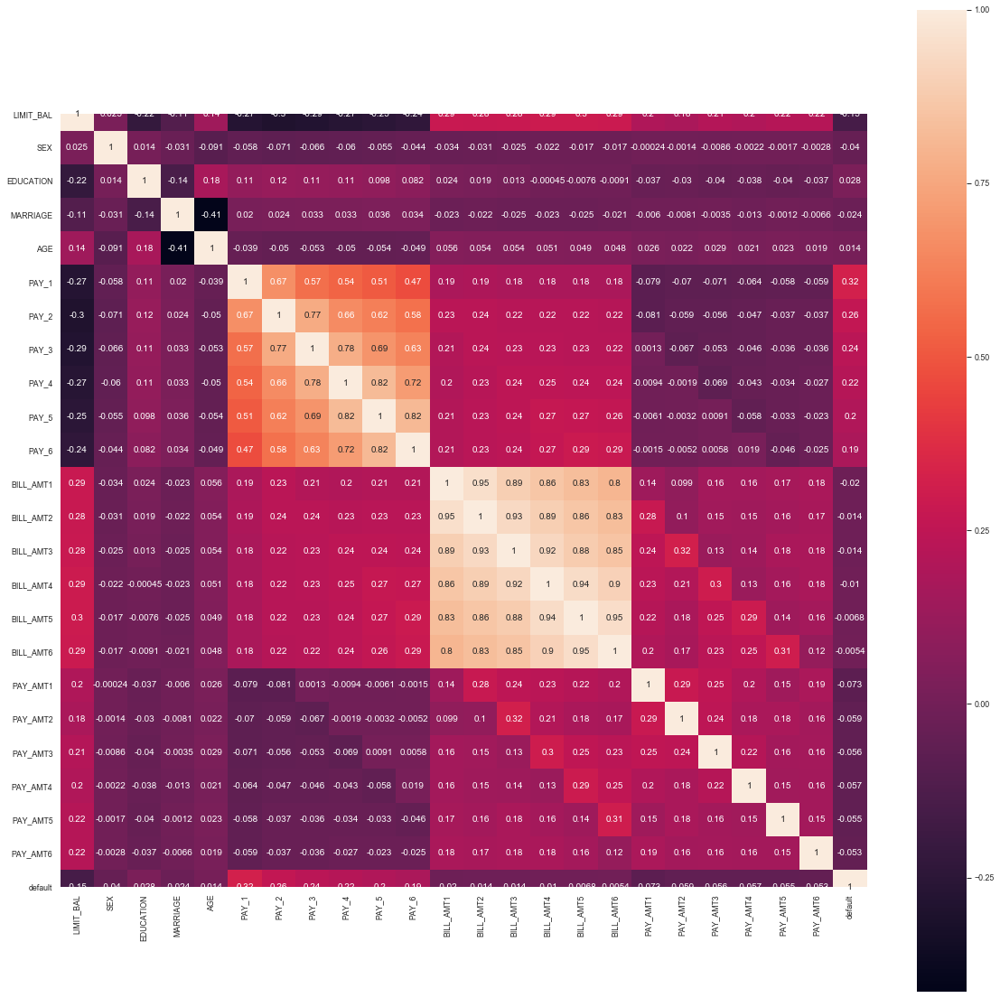

In [13]:
# Correlation

plt.figure(figsize = (20,20))
sns.heatmap(df.corr(),annot = True,square = True)

The heatmap shows that features are correlated with each other (collinearity), such like PAY_0,2,3,4,5,6 and BILL_AMT1,2,3,4,5,6.

In those cases, the correlation is positive.

# Data cleaning and further exploration

It was pointed out earlier that there are some undocumented labels. we will carry out the data cleaning here.

The 0 (undocumented), 5 and 6 (label unknown) in EDUCATION can also be put in a 'Other' category (thus 4)

In [14]:
fil = (df.EDUCATION == 5) | (df.EDUCATION == 6) | (df.EDUCATION == 0)
df.loc[fil, 'EDUCATION'] = 4
df.EDUCATION.value_counts()

2    14030
1    10585
3     4917
4      468
Name: EDUCATION, dtype: int64

In [15]:
# The 0 in MARRIAGE can be safely categorized as 'Other' (thus 3)

df.loc[df.MARRIAGE == 0, 'MARRIAGE'] = 3
df.MARRIAGE.value_counts()

2    15964
1    13659
3      377
Name: MARRIAGE, dtype: int64

Text(0, 0.5, 'Number')

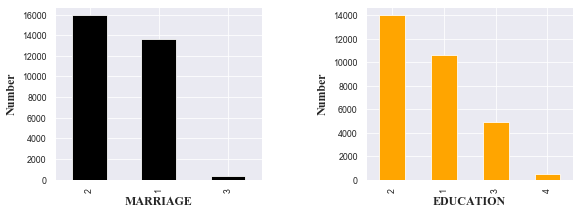

In [16]:
# We take a look at their distribution again.

plt.subplots_adjust(left = 0, bottom = 0, right = 1.2, top = 0.6, wspace = 0.5, hspace = 0.5)

plt.subplot(1, 2, 1)
df.MARRIAGE.value_counts().plot(kind = 'bar',color='black')
plt.xlabel("MARRIAGE", font)
plt.ylabel("Number", font)

plt.subplot(1, 2, 2)
df.EDUCATION.value_counts().plot(kind = 'bar',color='orange')
plt.xlabel("EDUCATION", font)
plt.ylabel("Number", font)

"-1" is paid duly, but there are "-2" and "0" labels in payment status variable. 

So let's combine them and put everything as "0"

In [17]:

fil = (df.PAY_1 == -2) | (df.PAY_1 == -1) | (df.PAY_1 == 0)
df.loc[fil, 'PAY_1'] = 0
fil = (df.PAY_2 == -2) | (df.PAY_2 == -1) | (df.PAY_2 == 0)
df.loc[fil, 'PAY_2'] = 0
fil = (df.PAY_3 == -2) | (df.PAY_3 == -1) | (df.PAY_3 == 0)
df.loc[fil, 'PAY_3'] = 0
fil = (df.PAY_4 == -2) | (df.PAY_4 == -1) | (df.PAY_4 == 0)
df.loc[fil, 'PAY_4'] = 0
fil = (df.PAY_5 == -2) | (df.PAY_5 == -1) | (df.PAY_5 == 0)
df.loc[fil, 'PAY_5'] = 0
fil = (df.PAY_6 == -2) | (df.PAY_6 == -1) | (df.PAY_6 == 0)
df.loc[fil, 'PAY_6'] = 0

In [18]:
# Histogram after clubbing "-2" and "-1" to "0" label

fig = make_subplots(rows= 3, cols=2,subplot_titles=pay_s.columns.to_list())  

fig.add_trace(go.Histogram(x= df["PAY_1"],name='PAY_1'),row = 1, col = 1)
fig.add_trace(go.Histogram(x= df["PAY_2"],name='PAY_2'),row = 2, col = 2)
fig.add_trace(go.Histogram(x= df["PAY_3"],name='PAY_3'),row = 3, col = 1)
fig.add_trace(go.Histogram(x= df["PAY_4"],name='PAY_4'),row = 1, col = 2)
fig.add_trace(go.Histogram(x= df["PAY_5"],name='PAY_5'),row = 2, col = 1)
fig.add_trace(go.Histogram(x= df["PAY_6"],name='PAY_6'),row = 3, col = 2)


fig.update_layout(bargap=0.2,height=600, width=800, title_text="Histogram Subplots of Previous Payment Status (After clubbing)")
fig.show()

We no longer have -1 and -2 present in the histogram plot we see

# Baseline models


A baseline model uses heuristics(not optimal or perfect) but sufficient, simple summary statistics, randomness, or machine learning to create predictions for a dataset. You can use these predictions to measure the baseline's performance (e.g., accuracy)-- this metric will then become what you compare any other machine learning algorithm against. So let's build a few classifiers without any hyperparameter tuning or feature engineering.

In [19]:
X = df.drop('default', axis=1)  
y = df['default']

# we split our dataset into 70:30

X_train,X_test,y_train,y_test = train_test_split(X,y,test_size=0.3,random_state=42,stratify=y)

In [20]:
random = RandomForestClassifier()
LR = LogisticRegression(random_state=0)
xgb = XGBClassifier()
catboost = CatBoostClassifier()
lgbm = LGBMClassifier()
svm = SVC()

In [21]:
# A function that returns the accuracy score, classification report, confusion matrix

def report(model,x_train,x_test,y_train,y_test):
    model.fit(x_train,y_train)
    y_pred = model.predict(x_test)
    print('accuracy score:',accuracy_score(y_test,y_pred))
    print('classification report:','\n',classification_report(y_test,y_pred))
    print('confusion matrix:','\n',confusion_matrix(y_test,y_pred))

In [22]:
# result for losgistic regression

report(LR,X_train,X_test,y_train,y_test)

accuracy score: 0.7787777777777778
classification report: 
               precision    recall  f1-score   support

           0       0.78      1.00      0.88      7009
           1       0.00      0.00      0.00      1991

    accuracy                           0.78      9000
   macro avg       0.39      0.50      0.44      9000
weighted avg       0.61      0.78      0.68      9000

confusion matrix: 
 [[7009    0]
 [1991    0]]


In [23]:
# result for xgboost

report(xgb,X_train,X_test,y_train,y_test)


accuracy score: 0.8182222222222222
classification report: 
               precision    recall  f1-score   support

           0       0.84      0.95      0.89      7009
           1       0.67      0.36      0.46      1991

    accuracy                           0.82      9000
   macro avg       0.75      0.65      0.68      9000
weighted avg       0.80      0.82      0.80      9000

confusion matrix: 
 [[6656  353]
 [1283  708]]


In [24]:
# result for random forest

report(random,X_train,X_test,y_train,y_test)

accuracy score: 0.8058888888888889
classification report: 
               precision    recall  f1-score   support

           0       0.83      0.94      0.88      7009
           1       0.61      0.33      0.43      1991

    accuracy                           0.81      9000
   macro avg       0.72      0.63      0.66      9000
weighted avg       0.78      0.81      0.78      9000

confusion matrix: 
 [[6599  410]
 [1337  654]]


In [25]:
# result for catboost

report(catboost,X_train,X_test,y_train,y_test)


Learning rate set to 0.037803
0:	learn: 0.6718312	total: 313ms	remaining: 5m 12s
1:	learn: 0.6518938	total: 332ms	remaining: 2m 45s
2:	learn: 0.6337904	total: 352ms	remaining: 1m 56s
3:	learn: 0.6171933	total: 368ms	remaining: 1m 31s
4:	learn: 0.6023219	total: 385ms	remaining: 1m 16s
5:	learn: 0.5884217	total: 412ms	remaining: 1m 8s
6:	learn: 0.5757987	total: 429ms	remaining: 1m
7:	learn: 0.5643900	total: 452ms	remaining: 56s
8:	learn: 0.5533945	total: 472ms	remaining: 51.9s
9:	learn: 0.5438571	total: 495ms	remaining: 49s
10:	learn: 0.5345166	total: 514ms	remaining: 46.3s
11:	learn: 0.5264850	total: 531ms	remaining: 43.7s
12:	learn: 0.5186749	total: 547ms	remaining: 41.5s
13:	learn: 0.5112926	total: 563ms	remaining: 39.7s
14:	learn: 0.5050405	total: 580ms	remaining: 38.1s
15:	learn: 0.4991863	total: 596ms	remaining: 36.7s
16:	learn: 0.4937634	total: 616ms	remaining: 35.6s
17:	learn: 0.4887811	total: 632ms	remaining: 34.5s
18:	learn: 0.4843897	total: 649ms	remaining: 33.5s
19:	learn: 0.

In [26]:
# result for light gbm

report(lgbm,X_train,X_test,y_train,y_test)


accuracy score: 0.8167777777777778
classification report: 
               precision    recall  f1-score   support

           0       0.84      0.95      0.89      7009
           1       0.66      0.36      0.47      1991

    accuracy                           0.82      9000
   macro avg       0.75      0.65      0.68      9000
weighted avg       0.80      0.82      0.80      9000

confusion matrix: 
 [[6631  378]
 [1271  720]]


In [27]:
# result for svc

report(svm,X_train,X_test,y_train,y_test)

accuracy score: 0.7794444444444445
classification report: 
               precision    recall  f1-score   support

           0       0.78      1.00      0.88      7009
           1       0.58      0.01      0.02      1991

    accuracy                           0.78      9000
   macro avg       0.68      0.50      0.45      9000
weighted avg       0.74      0.78      0.69      9000

confusion matrix: 
 [[6994   15]
 [1970   21]]


So the classifiers made use of, had accuracy scores of 0.805, 0.779, 0.818, 0.817, 0.818 and 0.779. We have to better this with parameter tuning and feature engineering.

# Feature Engineering

To begin with, all the categorical features (sex, marriage, education were one hot encoded. 

The one-hot encoding allows the representation of categorical data to be more expressive.


# Variance reduction between data points

Next, the variance between data points in the pay-amounts and limit balance were reduced in one instance and were not reduced in the second instance. This was done to evaluate the effect of variance on the performance of a model.

Furthermore, we had observed earlier the imbalance in the samples from the count plot of the target column.

We split the dataset in the ratio 70:30 for the train and test sets

Then we created the training data frame by remerging X_train and y_train.
                                             
In the train dataset, we observed the distribution of the samples and the imbalance in the samples was confirmed.


# Imbalance in samples

Due to the imbalance in the samples, we decided to take on a method called resampling.

WE carried out three types of resampling namely: Random Oversampling, Random Under sampling and the SMOTE technique.
	
1.) Random Oversampling: Randomly duplicate examples in the minority class and adds them to the training dataset. The           examples from the training dataset are selected randomly with replacement.

2.) Random Under sampling: Randomly selecting examples from the majority class to delete from the training dataset. This       process can be repeated until the desired class distribution is achieved, such as an equal number of examples for each     class.

3.) SMOTE (Synthetic Minority Oversampling Technique) : is an oversampling method which creates synthetic samples from the     minority class instead of creating copies. It selects 2 or more similar instances and perturb them one at a time by       random amount. 

In [28]:
df[['SEX','MARRIAGE','EDUCATION']] = df[['SEX','MARRIAGE','EDUCATION']].astype('object')

#One Hot encoding

df = pd.get_dummies(df)
df.head()

,LIMIT_BAL,AGE,PAY_1,PAY_2,PAY_3,PAY_4,PAY_5,PAY_6,BILL_AMT1,BILL_AMT2,BILL_AMT3,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default,SEX_1,SEX_2,EDUCATION_1,EDUCATION_2,EDUCATION_3,EDUCATION_4,MARRIAGE_1,MARRIAGE_2,MARRIAGE_3
0,20000.0,24,2,2,0,0,0,0,3913.0,3102.0,689.0,0.0,0.0,0.0,0.0,689.0,0.0,0.0,0.0,0.0,1,0,1,0,1,0,0,1,0,0
1,120000.0,26,0,2,0,0,0,2,2682.0,1725.0,2682.0,3272.0,3455.0,3261.0,0.0,1000.0,1000.0,1000.0,0.0,2000.0,1,0,1,0,1,0,0,0,1,0
2,90000.0,34,0,0,0,0,0,0,29239.0,14027.0,13559.0,14331.0,14948.0,15549.0,1518.0,1500.0,1000.0,1000.0,1000.0,5000.0,0,0,1,0,1,0,0,0,1,0
3,50000.0,37,0,0,0,0,0,0,46990.0,48233.0,49291.0,28314.0,28959.0,29547.0,2000.0,2019.0,1200.0,1100.0,1069.0,1000.0,0,0,1,0,1,0,0,1,0,0
4,50000.0,57,0,0,0,0,0,0,8617.0,5670.0,35835.0,20940.0,19146.0,19131.0,2000.0,36681.0,10000.0,9000.0,689.0,679.0,0,1,0,0,1,0,0,1,0,0


Our final dataset is finished, let's split the dataset in 70:30 ratio for train and test. This is the dataset without the reduction of variance.


In [29]:

X_train, X_test, y_train, y_test = train_test_split(X,y, test_size=0.3, stratify=y, random_state=42)

In [30]:
# create the training df by remerging X_train and y_train

df_train = X_train.join(y_train)

 We have observed that there is imbalance in the samples from the countplot of the default column above.
 Let's see the distribution of the samples in the train dataset

In [31]:

# Separate majority and minority classes
df_majority = df_train[df_train.default == 0]
df_minority = df_train[df_train.default == 1]

print(df_train.default.value_counts())

0    16355
1     4645
Name: default, dtype: int64


A.) Random Oversampling

In [32]:

# Upsample minority class
df_minority_upsampled = resample(df_minority, 
                                 replace=True,     # sample with replacement
                                 n_samples = 16355,    # to match majority class
                                 random_state= 42) # reproducible results
# Combine majority class with upsampled minority class
df_upsampled = pd.concat([df_majority, df_minority_upsampled])
# Display new class counts
df_upsampled.default.value_counts()

0    16355
1    16355
Name: default, dtype: int64

B) Random Undersampling:

In [33]:
# Downsample majority class
df_majority_downsampled = resample(df_majority, 
                                 replace=False,    # sample without replacement
                                 n_samples=4645,     # to match minority class
                                 random_state=587) # reproducible results
# Combine minority class with downsampled majority class
df_downsampled = pd.concat([df_majority_downsampled, df_minority])
# Display new class counts
df_downsampled.default.value_counts()

0    4645
1    4645
Name: default, dtype: int64

C) SMOTE: Synthetic Minority Oversampling Technique

In [34]:
df_smote,smote_ytrain = SMOTE(random_state=42).fit_sample(X_train,y_train)
df_smote = pd.DataFrame(data=df_smote,columns= list(X_train.columns), dtype=None, copy=False)
smote_ytrain = pd.Series(smote_ytrain)
len(df_smote)

32710

So we now have four sets of training data:


1) The normal train data with unbalance

2) Train data with oversampling

3) Train data with undersampling

4) Train data with SMOTE algorithm


# Building ML model using various algorithms and comparing them


On the training datasets the following classifiers were explored:

Logistic Regression

Random forest classifier

XGboost classifier

CATBoost classifier


# Basis for Selecting the Best Classifier


Recall score and accuracy score would be the basis for choosing    the best classifier.

The recall is the ability of the classifier to find all the positive samples.

The recall score for 1 would be the priority. The recall score should not be less than 0.5.

The accuracy score should be above 77%. This is because the zeros are 77% of the target column of the dataset.

The ROC_AUC_Score (Receiver Opereating Characteristics, Area Under the ROC curve) is another basis for choosing the best classifier. It tells how much a model is capable of distinguishing between classes. Higher the AUC, better the model is at predicting 0s as 0s and 1s as 1s.


First let's define a function which evaluates the model with train and test score and also performs a K-fold cross validation on the train dataset


In [35]:
def model_eval(algo, Xtrain,ytrain,Xtest,ytest):
    from sklearn.metrics import confusion_matrix,accuracy_score,roc_auc_score,roc_curve,classification_report

    algo.fit(Xtrain,ytrain)
    y_pred = algo.predict(Xtrain)
    y_train_prob = algo.predict_proba(Xtrain)[:,1]

    #print('confusion matrix-train\n',confusion_matrix(ytrain,y_pred))
    print('Overall Train Accuracy',accuracy_score(ytrain,y_pred))
    print('Train AUC Score',roc_auc_score(ytrain,y_train_prob))

    y_test_pred = algo.predict(Xtest)
    y_test_prob = algo.predict_proba(Xtest)[:,1]


    #print('confusion matrix-test\n',confusion_matrix(ytest,y_test_pred))
    print('Overall Test Accuracy',accuracy_score(ytest,y_test_pred))
    print('Test AUC Score',roc_auc_score(ytest,y_test_prob))
    print('Classification Report of Test\n',  classification_report(ytest, y_test_pred))
    
    
    kf = KFold(n_splits = 5,shuffle = True,random_state = 42)
    score=[]
    for train_idx,test_idx in kf.split(Xtrain,ytrain):
        xtrain_k,xtest_k = Xtrain.iloc[train_idx,:],Xtrain.iloc[test_idx,:]
        ytrain_k,ytest_k = ytrain.iloc[train_idx],ytrain.iloc[test_idx]
        algo.fit(xtrain_k,ytrain_k)
        y_pred_k = algo.predict(xtest_k)
        roc = roc_auc_score(ytest_k,y_pred_k)
        score.append(roc)
    print('K-Fold scores: %0.03f (+/- %0.5f)' % (np.mean(score),np.var(score,ddof=1)))

Logistic Regression

First we find out the best parameters using RandomizedSearchCv

In [36]:
xtrain_data = [X_train,df_upsampled.drop('default',axis = 1),df_downsampled.drop('default',axis = 1),df_smote]
ytrain_data = [y_train,df_upsampled['default'],df_downsampled['default'],smote_ytrain]
name = ['Normal Sampling' , 'Over Sampling' , 'Under Sampling' , 'SMOTE']

for i,j,k in zip(xtrain_data,ytrain_data,name):
    global best_log
    print('Data is ',k)
    best_log = []
    # Setup the hyperparameter grid, (not scaled data)
    param_grid = {'C': np.logspace(-5, 8, 15)}
    # Instantiate a logistic regression classifier
    logreg = LogisticRegression()
    # Instantiate the RandomizedSearchCV object
    logreg_cv = RandomizedSearchCV(logreg, param_grid ,scoring = 'roc_auc', cv=5, random_state=0)
    # Fit it to the data
    logreg_cv.fit(i,j)
    best_log.append(logreg_cv.best_params_)
    # Print the tuned parameters and score
    print("Tuned Logistic Regression Parameters: {}".format(logreg_cv.best_params_))
    print("_" * 100)

Data is  Normal Sampling
Tuned Logistic Regression Parameters: {'C': 268.2695795279727}
____________________________________________________________________________________________________
Data is  Over Sampling
Tuned Logistic Regression Parameters: {'C': 268.2695795279727}
____________________________________________________________________________________________________
Data is  Under Sampling
Tuned Logistic Regression Parameters: {'C': 100000000.0}
____________________________________________________________________________________________________
Data is  SMOTE
Tuned Logistic Regression Parameters: {'C': 11787686.347935867}
____________________________________________________________________________________________________


In [37]:
param_log =[{'C': 268.2695795279727},{'C': 11787686.347935867},{'C': 0.05179474679231213},{'C': 0.0007196856730011522}]

In [38]:
xtrain_data = [X_train,df_upsampled.drop('default',axis = 1),df_downsampled.drop('default',axis = 1),df_smote]
ytrain_data = [y_train,df_upsampled['default'],df_downsampled['default'],smote_ytrain]
name = ['Normal Sampling' , 'Over Sampling' , 'Under Sampling' , 'SMOTE']
index = [0,1,2,3]

for i,j,k,l in zip(xtrain_data,ytrain_data,name,index):
    print('Data is ',k,' And with hyper parameter ',param_log[l])
    model_eval(LogisticRegression(**param_log[l],random_state= 42), i,j,X_test,y_test)
    print("_" * 60)

Data is  Normal Sampling  And with hyper parameter  {'C': 268.2695795279727}
Overall Train Accuracy 0.7788095238095238
Train AUC Score 0.6544947921174401
Overall Test Accuracy 0.7787777777777778
Test AUC Score 0.6410924706908008
Classification Report of Test
               precision    recall  f1-score   support

           0       0.78      1.00      0.88      7009
           1       0.00      0.00      0.00      1991

    accuracy                           0.78      9000
   macro avg       0.39      0.50      0.44      9000
weighted avg       0.61      0.78      0.68      9000

K-Fold scores: 0.500 (+/- 0.00000)
____________________________________________________________
Data is  Over Sampling  And with hyper parameter  {'C': 11787686.347935867}
Overall Train Accuracy 0.6859675940079486
Train AUC Score 0.73684464263133
Overall Test Accuracy 0.7104444444444444
Test AUC Score 0.729431428444694
Classification Report of Test
               precision    recall  f1-score   support

      

Random Forest Classifier

First we find out the best parameters using RandomizedSearchCv

In [39]:
xtrain_data = [X_train,df_upsampled.drop('default',axis = 1),df_downsampled.drop('default',axis = 1),df_smote]
ytrain_data = [y_train,df_upsampled['default'],df_downsampled['default'],smote_ytrain]
name = ['Normal Sampling' , 'Over Sampling' , 'Under Sampling' , 'SMOTE']

for i,j,k in zip(xtrain_data,ytrain_data,name):
    global best_rf
    best_rf =[]
    print('Data is ',k)
    # Instantiate a Random forest classifier: tree
    rfc = RandomForestClassifier(random_state = 42)

    # Setup the parameters and distributions to sample from: param_dist
    params = {'n_estimators' : sp_randint(50,200),
              'max_features' : sp_randint(1,24),'max_depth': sp_randint(2,10),
             'min_samples_leaf':sp_randint(1,20),
             'min_samples_split':sp_randint(2,20),
             'criterion':['gini','entropy']}

    # Instantiate the RandomizedSearchCV object
    rsearch_rfc = RandomizedSearchCV(rfc, param_distributions= params, cv = 5, scoring = 'roc_auc',n_iter = 200,random_state = 42,n_jobs = -1,return_train_score = True)

    # Fit it to the data
    rsearch_rfc.fit(i,j)
    best_rf.append(rsearch_rfc.best_params_)
    print("Tuned Random Tree Parameters: {}".format(rsearch_rfc.best_params_), "for",k)
    print("_" * 100)

Data is  Normal Sampling
Tuned Random Tree Parameters: {'criterion': 'entropy', 'max_depth': 9, 'max_features': 13, 'min_samples_leaf': 1, 'min_samples_split': 18, 'n_estimators': 120} for Normal Sampling
____________________________________________________________________________________________________
Data is  Over Sampling
Tuned Random Tree Parameters: {'criterion': 'entropy', 'max_depth': 9, 'max_features': 22, 'min_samples_leaf': 1, 'min_samples_split': 12, 'n_estimators': 162} for Over Sampling
____________________________________________________________________________________________________
Data is  Under Sampling
Tuned Random Tree Parameters: {'criterion': 'gini', 'max_depth': 9, 'max_features': 7, 'min_samples_leaf': 13, 'min_samples_split': 11, 'n_estimators': 191} for Under Sampling
____________________________________________________________________________________________________
Data is  SMOTE
Tuned Random Tree Parameters: {'criterion': 'entropy', 'max_depth': 9, 'max_

In [40]:
param_rf = [{'criterion': 'entropy', 'max_depth': 9, 'max_features': 13, 'min_samples_leaf': 1, 'min_samples_split': 18, 'n_estimators': 120},
           {'criterion': 'entropy', 'max_depth': 9, 'max_features': 22, 'min_samples_leaf': 1, 'min_samples_split': 12, 'n_estimators': 162},
           {'criterion': 'gini', 'max_depth': 9, 'max_features': 7, 'min_samples_leaf': 13, 'min_samples_split': 11, 'n_estimators': 191},
           {'criterion': 'entropy', 'max_depth': 9, 'max_features': 16, 'min_samples_leaf': 8, 'min_samples_split': 7, 'n_estimators': 166}]

In [41]:
xtrain_data = [X_train,df_upsampled.drop('default',axis = 1),df_downsampled.drop('default',axis = 1),df_smote]
ytrain_data = [y_train,df_upsampled['default'],df_downsampled['default'],smote_ytrain]
name = ['Normal Sampling' , 'Over Sampling' , 'Under Sampling' , 'SMOTE']
index = [0,1,2,3]

for i,j,k,l in zip(xtrain_data,ytrain_data,name,index):
    print('Data is ',k,' And with hyper parameter ',param_rf[l])
    model_eval(RandomForestClassifier(**param_rf[l],random_state= 42), i,j,X_test,y_test)
    print("_" * 60)

Data is  Normal Sampling  And with hyper parameter  {'criterion': 'entropy', 'max_depth': 9, 'max_features': 13, 'min_samples_leaf': 1, 'min_samples_split': 18, 'n_estimators': 120}
Overall Train Accuracy 0.8408571428571429
Train AUC Score 0.8436625148621526
Overall Test Accuracy 0.8175555555555556
Test AUC Score 0.7762244983292271
Classification Report of Test
               precision    recall  f1-score   support

           0       0.84      0.95      0.89      7009
           1       0.67      0.35      0.46      1991

    accuracy                           0.82      9000
   macro avg       0.75      0.65      0.67      9000
weighted avg       0.80      0.82      0.79      9000

K-Fold scores: 0.658 (+/- 0.00005)
____________________________________________________________
Data is  Over Sampling  And with hyper parameter  {'criterion': 'entropy', 'max_depth': 9, 'max_features': 22, 'min_samples_leaf': 1, 'min_samples_split': 12, 'n_estimators': 162}
Overall Train Accuracy 0.7750535

XGboost Classifier

First we find out the best parameters using RandomizedSearchCv

In [42]:
xtrain_data = [X_train,df_upsampled.drop('default',axis = 1),df_downsampled.drop('default',axis = 1),df_smote]
ytrain_data = [y_train,df_upsampled['default'],df_downsampled['default'],smote_ytrain]
name = ['Normal Sampling' , 'Over Sampling' , 'Under Sampling' , 'SMOTE']

for i,j,k in zip(xtrain_data,ytrain_data,name):
    global best_xgb
    best_xgb =[]
    print('Data is ',k)  # Instantiate a XGBoost classifier
    xgb= XGBClassifier()

    param_grid = {"learning_rate"    : [0.05, 0.10, 0.15, 0.20, 0.25, 0.30],
                  "max_depth"        : [3, 4, 5, 6, 8, 10, 12, 15],
                 "min_child_weight" : [1, 3, 5, 7],
                 "gamma"            : [0.0, 0.1, 0.2, 0.3, 0.4],
                 "colsample_bytree" : [0.3, 0.4, 0.5, 0.7]}

    #Building a 5 fold CV GridSearchCV objec0
    xgb_RS = RandomizedSearchCV(xgb, param_grid, cv = 5, scoring = 'roc_auc', n_iter = 20, n_jobs = -1)

    #Fitting the grid to the training data
    xgb_RS.fit(i,j)
    best_xgb.append(xgb_RS.best_params_)
    print("Tuned XG Boost Parameters: {}".format(xgb_RS.best_params_), "for",k)
    print("_" * 100)

Data is  Normal Sampling
Tuned XG Boost Parameters: {'min_child_weight': 3, 'max_depth': 3, 'learning_rate': 0.15, 'gamma': 0.0, 'colsample_bytree': 0.3} for Normal Sampling
____________________________________________________________________________________________________
Data is  Over Sampling
Tuned XG Boost Parameters: {'min_child_weight': 1, 'max_depth': 15, 'learning_rate': 0.15, 'gamma': 0.0, 'colsample_bytree': 0.4} for Over Sampling
____________________________________________________________________________________________________
Data is  Under Sampling
Tuned XG Boost Parameters: {'min_child_weight': 7, 'max_depth': 4, 'learning_rate': 0.05, 'gamma': 0.1, 'colsample_bytree': 0.5} for Under Sampling
____________________________________________________________________________________________________
Data is  SMOTE
Tuned XG Boost Parameters: {'min_child_weight': 5, 'max_depth': 12, 'learning_rate': 0.05, 'gamma': 0.2, 'colsample_bytree': 0.4} for SMOTE
_________________________

In [43]:
param_xgb = [{'min_child_weight': 3, 'max_depth': 6, 'learning_rate': 0.05, 'gamma': 0.4, 'colsample_bytree': 0.7},
            {'min_child_weight': 1, 'max_depth': 15, 'learning_rate': 0.2, 'gamma': 0.1, 'colsample_bytree': 0.5},
            {'min_child_weight': 7, 'max_depth': 4, 'learning_rate': 0.1, 'gamma': 0.1, 'colsample_bytree': 0.5},
            {'min_child_weight': 3, 'max_depth': 15, 'learning_rate': 0.05, 'gamma': 0.2, 'colsample_bytree': 0.3}]

In [44]:
xtrain_data = [X_train,df_upsampled.drop('default',axis = 1),df_downsampled.drop('default',axis = 1),df_smote]
ytrain_data = [y_train,df_upsampled['default'],df_downsampled['default'],smote_ytrain]
name = ['Normal Sampling' , 'Over Sampling' , 'Under Sampling' , 'SMOTE']
index = [0,1,2,3]

for i,j,k,l in zip(xtrain_data,ytrain_data,name,index):
    print('Data is ',k,' And with hyper parameter ',param_xgb[l])
    model_eval(XGBClassifier(**param_xgb[l]), i,j,X_test,y_test)
    print("_" * 60)

Data is  Normal Sampling  And with hyper parameter  {'min_child_weight': 3, 'max_depth': 6, 'learning_rate': 0.05, 'gamma': 0.4, 'colsample_bytree': 0.7}
Overall Train Accuracy 0.8392857142857143
Train AUC Score 0.8413789313334818
Overall Test Accuracy 0.8196666666666667
Test AUC Score 0.7783824112486787
Classification Report of Test
               precision    recall  f1-score   support

           0       0.84      0.95      0.89      7009
           1       0.67      0.36      0.47      1991

    accuracy                           0.82      9000
   macro avg       0.76      0.65      0.68      9000
weighted avg       0.80      0.82      0.80      9000

K-Fold scores: 0.659 (+/- 0.00006)
____________________________________________________________
Data is  Over Sampling  And with hyper parameter  {'min_child_weight': 1, 'max_depth': 15, 'learning_rate': 0.2, 'gamma': 0.1, 'colsample_bytree': 0.5}
Overall Train Accuracy 0.9961173952919596
Train AUC Score 0.9999562276197421
Overall Tes

Catboost Classifier

First we find out the best parameters using RandomizedSearchCv

In [45]:
xtrain_data = [X_train,df_upsampled.drop('default',axis = 1),df_downsampled.drop('default',axis = 1),df_smote]
ytrain_data = [y_train,df_upsampled['default'],df_downsampled['default'],smote_ytrain]
name = ['Normal Sampling' , 'Over Sampling' , 'Under Sampling' , 'SMOTE']

for i,j,k in zip(xtrain_data,ytrain_data,name):
    global best_cat
    best_cat =[]
    print('Data is ',k)  # Instantiate a XGBoost classifier
    cat= CatBoostClassifier()

    param_cat =params = {'depth': [4, 7, 10],'learning_rate' : [0.03, 0.1, 0.15],'l2_leaf_reg': [1,4,9],'iterations': [20]}
               
    cat_RS = RandomizedSearchCV(cat, param_distributions=param_cat, cv=5,return_train_score=True,refit='cohen_kappa_quadratic',n_iter=200,n_jobs= -1,scoring={'accuracy': make_scorer(accuracy_score),'cohen_kappa_quadratic': QUADRATIC_WEIGHT_SCORER},verbose=1,random_state=42)

    #Fitting the grid to the training data
    cat_RS.fit(i,j)
    best_cat.append(cat_RS.best_params_)
    print("Tuned cat Boost Parameters: {}".format(cat_RS.best_params_), "for",k)
    print("_" * 100)

Data is  Normal Sampling
Fitting 5 folds for each of 27 candidates, totalling 135 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done  42 tasks      | elapsed:   41.8s
[Parallel(n_jobs=-1)]: Done 135 out of 135 | elapsed:  3.4min finished


0:	learn: 0.6145271	total: 36.9ms	remaining: 702ms
1:	learn: 0.5575184	total: 78.8ms	remaining: 709ms
2:	learn: 0.5191103	total: 113ms	remaining: 643ms
3:	learn: 0.4933984	total: 157ms	remaining: 628ms
4:	learn: 0.4745594	total: 186ms	remaining: 558ms
5:	learn: 0.4606005	total: 217ms	remaining: 505ms
6:	learn: 0.4504875	total: 257ms	remaining: 478ms
7:	learn: 0.4426415	total: 290ms	remaining: 434ms
8:	learn: 0.4381814	total: 326ms	remaining: 398ms
9:	learn: 0.4343972	total: 359ms	remaining: 359ms
10:	learn: 0.4314063	total: 405ms	remaining: 331ms
11:	learn: 0.4300546	total: 426ms	remaining: 284ms
12:	learn: 0.4278435	total: 478ms	remaining: 257ms
13:	learn: 0.4257392	total: 514ms	remaining: 220ms
14:	learn: 0.4239918	total: 552ms	remaining: 184ms
15:	learn: 0.4229473	total: 590ms	remaining: 147ms
16:	learn: 0.4218281	total: 628ms	remaining: 111ms
17:	learn: 0.4204780	total: 669ms	remaining: 74.3ms
18:	learn: 0.4194683	total: 706ms	remaining: 37.2ms
19:	learn: 0.4185982	total: 738ms	rem

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done  42 tasks      | elapsed:   26.2s
[Parallel(n_jobs=-1)]: Done 135 out of 135 | elapsed:  3.6min finished


0:	learn: 0.6469287	total: 153ms	remaining: 2.9s
1:	learn: 0.6168866	total: 311ms	remaining: 2.8s
2:	learn: 0.5923443	total: 516ms	remaining: 2.92s
3:	learn: 0.5743752	total: 681ms	remaining: 2.72s
4:	learn: 0.5608684	total: 873ms	remaining: 2.62s
5:	learn: 0.5469885	total: 1.05s	remaining: 2.45s
6:	learn: 0.5360301	total: 1.25s	remaining: 2.32s
7:	learn: 0.5266299	total: 1.42s	remaining: 2.12s
8:	learn: 0.5182944	total: 1.62s	remaining: 1.98s
9:	learn: 0.5112758	total: 1.78s	remaining: 1.78s
10:	learn: 0.5062323	total: 1.99s	remaining: 1.62s
11:	learn: 0.5019831	total: 2.15s	remaining: 1.43s
12:	learn: 0.4974622	total: 2.34s	remaining: 1.26s
13:	learn: 0.4927208	total: 2.52s	remaining: 1.08s
14:	learn: 0.4904648	total: 2.71s	remaining: 902ms
15:	learn: 0.4876719	total: 2.87s	remaining: 717ms
16:	learn: 0.4839453	total: 3.07s	remaining: 541ms
17:	learn: 0.4806579	total: 3.23s	remaining: 359ms
18:	learn: 0.4790996	total: 3.43s	remaining: 180ms
19:	learn: 0.4746447	total: 3.6s	remaining:

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done  42 tasks      | elapsed:   11.5s
[Parallel(n_jobs=-1)]: Done 135 out of 135 | elapsed:  2.1min finished


0:	learn: 0.6548509	total: 27.1ms	remaining: 515ms
1:	learn: 0.6291856	total: 40.5ms	remaining: 365ms
2:	learn: 0.6091909	total: 56.7ms	remaining: 321ms
3:	learn: 0.5947410	total: 80.5ms	remaining: 322ms
4:	learn: 0.5830481	total: 101ms	remaining: 302ms
5:	learn: 0.5766528	total: 121ms	remaining: 283ms
6:	learn: 0.5714295	total: 140ms	remaining: 260ms
7:	learn: 0.5657287	total: 158ms	remaining: 237ms
8:	learn: 0.5609732	total: 176ms	remaining: 215ms
9:	learn: 0.5573776	total: 194ms	remaining: 194ms
10:	learn: 0.5549975	total: 229ms	remaining: 188ms
11:	learn: 0.5527438	total: 250ms	remaining: 167ms
12:	learn: 0.5498364	total: 275ms	remaining: 148ms
13:	learn: 0.5465759	total: 294ms	remaining: 126ms
14:	learn: 0.5446502	total: 318ms	remaining: 106ms
15:	learn: 0.5430589	total: 338ms	remaining: 84.4ms
16:	learn: 0.5414482	total: 367ms	remaining: 64.8ms
17:	learn: 0.5395196	total: 386ms	remaining: 42.9ms
18:	learn: 0.5387835	total: 406ms	remaining: 21.4ms
19:	learn: 0.5371167	total: 427ms

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done  42 tasks      | elapsed:   30.8s
[Parallel(n_jobs=-1)]: Done 135 out of 135 | elapsed:  5.1min finished


0:	learn: 0.6353363	total: 88ms	remaining: 1.67s
1:	learn: 0.5868049	total: 154ms	remaining: 1.38s
2:	learn: 0.5333936	total: 216ms	remaining: 1.22s
3:	learn: 0.5047194	total: 272ms	remaining: 1.09s
4:	learn: 0.4710829	total: 346ms	remaining: 1.04s
5:	learn: 0.4470084	total: 405ms	remaining: 946ms
6:	learn: 0.4277968	total: 471ms	remaining: 875ms
7:	learn: 0.4136124	total: 544ms	remaining: 816ms
8:	learn: 0.4009471	total: 594ms	remaining: 726ms
9:	learn: 0.3941826	total: 653ms	remaining: 653ms
10:	learn: 0.3875981	total: 729ms	remaining: 596ms
11:	learn: 0.3748532	total: 808ms	remaining: 538ms
12:	learn: 0.3667250	total: 884ms	remaining: 476ms
13:	learn: 0.3632731	total: 946ms	remaining: 405ms
14:	learn: 0.3557195	total: 1.01s	remaining: 337ms
15:	learn: 0.3507019	total: 1.1s	remaining: 275ms
16:	learn: 0.3488726	total: 1.18s	remaining: 207ms
17:	learn: 0.3419654	total: 1.26s	remaining: 140ms
18:	learn: 0.3376552	total: 1.33s	remaining: 70ms
19:	learn: 0.3350540	total: 1.39s	remaining:

In [46]:
param_cat = [{'learning_rate': 0.15, 'l2_leaf_reg': 9, 'iterations': 20, 'depth': 7},
            {'learning_rate': 0.15, 'l2_leaf_reg': 1, 'iterations': 20, 'depth': 10},
            {'learning_rate': 0.15, 'l2_leaf_reg': 4, 'iterations': 20, 'depth': 7},
            {'learning_rate': 0.1, 'l2_leaf_reg': 9, 'iterations': 20, 'depth': 7}]

In [47]:

xtrain_data = [X_train,df_upsampled.drop('default',axis = 1),df_downsampled.drop('default',axis = 1),df_smote]
ytrain_data = [y_train,df_upsampled['default'],df_downsampled['default'],smote_ytrain]
name = ['Normal Sampling' , 'Over Sampling' , 'Under Sampling' , 'SMOTE']
index = [0,1,2,3]

for i,j,k,l in zip(xtrain_data,ytrain_data,name,index):
    print('Data is ',k,' And with hyper parameter ',param_cat[l])
    model_eval(CatBoostClassifier(**param_cat[l]), i,j,X_test,y_test)
    print("_" * 60)

Data is  Normal Sampling  And with hyper parameter  {'learning_rate': 0.15, 'l2_leaf_reg': 9, 'iterations': 20, 'depth': 7}
0:	learn: 0.6145271	total: 46.4ms	remaining: 882ms
1:	learn: 0.5575184	total: 84ms	remaining: 756ms
2:	learn: 0.5191103	total: 117ms	remaining: 663ms
3:	learn: 0.4933984	total: 167ms	remaining: 667ms
4:	learn: 0.4745594	total: 201ms	remaining: 603ms
5:	learn: 0.4606005	total: 232ms	remaining: 541ms
6:	learn: 0.4504875	total: 272ms	remaining: 505ms
7:	learn: 0.4426415	total: 313ms	remaining: 470ms
8:	learn: 0.4381814	total: 348ms	remaining: 425ms
9:	learn: 0.4343972	total: 388ms	remaining: 388ms
10:	learn: 0.4314063	total: 431ms	remaining: 352ms
11:	learn: 0.4300546	total: 450ms	remaining: 300ms
12:	learn: 0.4278435	total: 483ms	remaining: 260ms
13:	learn: 0.4257392	total: 518ms	remaining: 222ms
14:	learn: 0.4239918	total: 557ms	remaining: 186ms
15:	learn: 0.4229473	total: 598ms	remaining: 149ms
16:	learn: 0.4218281	total: 634ms	remaining: 112ms
17:	learn: 0.420478

# Method 2 (Reducing Variance)

Next, let's reduce the variance in the pay-amounts and limit bal

In [48]:
def PAY_AMT1(PAY_AMT1):
    if PAY_AMT1 < 1000:
        return 0
    elif (PAY_AMT1 >= 1000) & (PAY_AMT1 < 4000):
        return 1
    elif (PAY_AMT1 >= 4000) & (PAY_AMT1 < 18000):
        return 2
    elif PAY_AMT1 >= 18000:
        return 3

df.PAY_AMT1 = df.PAY_AMT1.apply(PAY_AMT1)


def PAY_AMT2(PAY_AMT2):
    if PAY_AMT2 < 1000:
        return 0
    elif (PAY_AMT2 >= 1000) & (PAY_AMT2 < 2000):
        return 1
    elif (PAY_AMT2 >= 2000) & (PAY_AMT2 < 5000):
        return 2
    elif (PAY_AMT2 >= 5000) & (PAY_AMT2 < 16000):
        return 3
    elif PAY_AMT2 >= 16000:
        return 4

df.PAY_AMT2 = df.PAY_AMT2.apply(PAY_AMT2)


In [49]:
def PAY_AMT3(PAY_AMT3):
    if PAY_AMT3 < 1000:
        return 0
    elif (PAY_AMT3 >= 1000) & (PAY_AMT3 < 3000):
        return 1
    elif (PAY_AMT3 >= 3000) & (PAY_AMT3 < 5000):
        return 2
    elif (PAY_AMT3 >= 5000) & (PAY_AMT3 < 17000):
        return 3
    elif PAY_AMT3 >= 17000:
        return 4

df.PAY_AMT3 = df.PAY_AMT3.apply(PAY_AMT3)

def PAY_AMT4(PAY_AMT4):
    if PAY_AMT4 < 1000:
        return 0
    elif (PAY_AMT4 >= 1000) & (PAY_AMT4 < 2000):
        return 1
    elif (PAY_AMT4 >= 2000) & (PAY_AMT4 < 5000):
        return 2
    elif (PAY_AMT4 >= 5000) & (PAY_AMT4 < 18000):
        return 3
    elif PAY_AMT4 >= 18000:
        return 4

df.PAY_AMT4 = df.PAY_AMT4.apply(PAY_AMT4)

In [50]:
def PAY_AMT5(PAY_AMT5):
    if PAY_AMT5 < 1000:
        return 0
    elif (PAY_AMT5 >= 1000) & (PAY_AMT5 < 3000):
        return 1
    elif (PAY_AMT5 >= 3000) & (PAY_AMT5 < 5000):
        return 2
    elif (PAY_AMT5 >= 5000) & (PAY_AMT5 < 20000):
        return 3
    elif PAY_AMT5 >= 20000:
        return 4
    
df.PAY_AMT5 = df.PAY_AMT5.apply(PAY_AMT5)    
    
def PAY_AMT6(PAY_AMT6):
    if PAY_AMT6 < 1000:
        return 0
    elif (PAY_AMT6 >= 1000) & (PAY_AMT6 < 3000):
        return 1
    elif (PAY_AMT6 >= 3000) & (PAY_AMT6 < 5000):
        return 2
    elif (PAY_AMT6 >= 5000) & (PAY_AMT6 < 20000):
        return 3
    elif PAY_AMT6 >= 20000:
        return 4
    
df.PAY_AMT6 = df.PAY_AMT6.apply(PAY_AMT6)

In [51]:
def LIMIT_BAL(LIMIT_BAL):
    if LIMIT_BAL < 50000:
        return 0
    elif (LIMIT_BAL >= 50000) & (LIMIT_BAL < 150000):
        return 1
    elif (LIMIT_BAL >= 150000) & (LIMIT_BAL < 250000):
        return 2
    elif LIMIT_BAL >= 250000:
        return 3
    
df.LIMIT_BAL = df.LIMIT_BAL.apply(LIMIT_BAL)

checking the replaced columns

In [52]:
df[['PAY_AMT1','PAY_AMT2']]

,PAY_AMT1,PAY_AMT2
0,0,0
1,0,1
2,1,1
3,1,2
4,1,4
...,...,...
29995,2,4
29996,1,2
29997,0,0
29998,3,2


checking the new dataframe

In [53]:
X = df.drop('default', axis=1)  
y = df['default']

In [54]:
X

,LIMIT_BAL,AGE,PAY_1,PAY_2,PAY_3,PAY_4,PAY_5,PAY_6,BILL_AMT1,BILL_AMT2,BILL_AMT3,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,SEX_1,SEX_2,EDUCATION_1,EDUCATION_2,EDUCATION_3,EDUCATION_4,MARRIAGE_1,MARRIAGE_2,MARRIAGE_3
0,0,24,2,2,0,0,0,0,3913.0,3102.0,689.0,0.0,0.0,0.0,0,0,0,0,0,0,0,1,0,1,0,0,1,0,0
1,1,26,0,2,0,0,0,2,2682.0,1725.0,2682.0,3272.0,3455.0,3261.0,0,1,1,1,0,1,0,1,0,1,0,0,0,1,0
2,1,34,0,0,0,0,0,0,29239.0,14027.0,13559.0,14331.0,14948.0,15549.0,1,1,1,1,1,3,0,1,0,1,0,0,0,1,0
3,1,37,0,0,0,0,0,0,46990.0,48233.0,49291.0,28314.0,28959.0,29547.0,1,2,1,1,1,1,0,1,0,1,0,0,1,0,0
4,1,57,0,0,0,0,0,0,8617.0,5670.0,35835.0,20940.0,19146.0,19131.0,1,4,3,3,0,0,1,0,0,1,0,0,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29995,2,39,0,0,0,0,0,0,188948.0,192815.0,208365.0,88004.0,31237.0,15980.0,2,4,3,2,3,1,1,0,0,0,1,0,1,0,0
29996,2,43,0,0,0,0,0,0,1683.0,1828.0,3502.0,8979.0,5190.0,0.0,1,2,3,0,0,0,1,0,0,0,1,0,0,1,0
29997,0,37,4,3,2,0,0,0,3565.0,3356.0,2758.0,20878.0,20582.0,19357.0,0,0,4,2,1,2,1,0,0,1,0,0,0,1,0
29998,1,41,1,0,0,0,0,0,-1645.0,78379.0,76304.0,52774.0,11855.0,48944.0,3,2,1,1,4,1,1,0,0,0,1,0,1,0,0


Checking the target column

In [55]:
y

0        1
1        1
2        0
3        0
4        0
        ..
29995    0
29996    0
29997    1
29998    1
29999    1
Name: default, Length: 30000, dtype: int64

Our final dataset is finished, let's split the dataset in 70:30 ratio for train and test

In [56]:
X_train, X_test, y_train, y_test = train_test_split(X,y, test_size=0.3, stratify=y, random_state=42)

In [57]:
X_train

,LIMIT_BAL,AGE,PAY_1,PAY_2,PAY_3,PAY_4,PAY_5,PAY_6,BILL_AMT1,BILL_AMT2,BILL_AMT3,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,SEX_1,SEX_2,EDUCATION_1,EDUCATION_2,EDUCATION_3,EDUCATION_4,MARRIAGE_1,MARRIAGE_2,MARRIAGE_3
11018,2,32,0,0,0,0,0,0,156098.0,156259.0,155404.0,153234.0,156731.0,155818.0,2,3,3,3,3,3,0,1,0,1,0,0,0,1,0
1710,1,30,0,0,0,0,2,0,28383.0,32903.0,42283.0,51539.0,50583.0,52588.0,2,3,3,0,1,1,0,1,1,0,0,0,0,1,0
4618,1,29,0,0,0,0,0,0,73722.0,75323.0,64277.0,45455.0,42231.0,42804.0,1,2,1,1,1,1,1,0,1,0,0,0,0,1,0
5482,0,27,0,0,0,0,0,0,7286.0,2160.0,780.0,0.0,0.0,0.0,1,0,0,0,0,0,0,1,0,1,0,0,1,0,0
26187,1,30,0,0,0,0,0,0,0.0,2070.0,0.0,0.0,0.0,0.0,1,0,0,0,0,0,0,1,1,0,0,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
25780,2,32,0,0,0,0,0,0,10701.0,0.0,0.0,0.0,0.0,0.0,0,0,0,0,0,0,0,1,0,1,0,0,1,0,0
13921,1,24,0,0,0,0,0,2,112336.0,113351.0,115515.0,113948.0,122127.0,121962.0,2,2,2,3,2,0,0,1,0,1,0,0,0,1,0
3794,1,24,0,0,0,0,0,0,75796.0,76004.0,67187.0,49924.0,33188.0,19826.0,1,2,1,2,1,1,0,1,1,0,0,0,0,1,0
27565,3,57,1,0,0,0,0,0,0.0,0.0,860.0,246.0,-46.0,-46.0,0,0,0,0,0,0,1,0,1,0,0,0,1,0,0


create the training dataframe by remerging X_train and y_train

In [58]:
df_train = X_train.join(y_train)

In [59]:
# We have observed that there is imbalance in the samples from the countplot of the default column above.
# Let's see the distribution of the samples in the train dataset

# Separate majority and minority classes
df_majority = df_train[df_train.default == 0]
df_minority = df_train[df_train.default == 1]

print(df_train.default.value_counts())

0    16355
1     4645
Name: default, dtype: int64


Random Oversampling

In [60]:
# Upsample minority class
df_minority_upsampled = resample(df_minority, 
                                 replace=True,     # sample with replacement
                                 n_samples = 16355,    # to match majority class
                                 random_state= 42) # reproducible results
# Combine majority class with upsampled minority class
df_upsampled = pd.concat([df_majority, df_minority_upsampled])
# Display new class counts
df_upsampled.default.value_counts()

0    16355
1    16355
Name: default, dtype: int64

Random Undersampling

In [61]:
# Downsample majority class
df_majority_downsampled = resample(df_majority, 
                                 replace=False,    # sample without replacement
                                 n_samples=4645,     # to match minority class
                                 random_state=587) # reproducible results
# Combine minority class with downsampled majority class
df_downsampled = pd.concat([df_majority_downsampled, df_minority])
# Display new class counts
df_downsampled.default.value_counts()

0    4645
1    4645
Name: default, dtype: int64

SMOTE

In [62]:
X_SMOTE,y_SMOTE = SMOTE(random_state=42).fit_sample(X_train,y_train)
X_SMOTE = pd.DataFrame(X_SMOTE,columns= list(X_train.columns), dtype=None, copy=False)
y_SMOTE = pd.Series(y_SMOTE)
len(X_SMOTE)

32710

Now let's find out the accuracy and recall scores for each of the classifiers

 Logistic Regression
        
 Let's first find out the best parameters for all the datasets

In [63]:
xtrain_data = [X_train,df_upsampled.drop('default',axis = 1),df_downsampled.drop('default',axis = 1),X_SMOTE]
ytrain_data = [y_train,df_upsampled['default'],df_downsampled['default'],y_SMOTE]
name = ['Normal Sampling' , 'Over Sampling' , 'Under Sampling' , 'SMOTE']

for i,j,k in zip(xtrain_data,ytrain_data,name):
    global best_log
    print('Data is ',k)
    best_log = []
    # Setup the hyperparameter grid, (not scaled data)
    param_grid = {'C': np.logspace(-10, 13, 15)}
    # Instantiate a logistic regression classifier
    logreg = LogisticRegression(solver='liblinear',multi_class='ovr')
    # Instantiate the RandomizedSearchCV object
    logreg_cv = RandomizedSearchCV(logreg, param_grid ,scoring = 'roc_auc', cv=5, random_state=0)
    # Fit it to the data
    logreg_cv.fit(i,j)
    best_log.append(logreg_cv.best_params_)
    # Print the tuned parameters and score
    print("Tuned Logistic Regression Parameters: {}".format(logreg_cv.best_params_))
    print("_" * 100)

Data is  Normal Sampling
Tuned Logistic Regression Parameters: {'C': 31.622776601683793}
____________________________________________________________________________________________________
Data is  Over Sampling
Tuned Logistic Regression Parameters: {'C': 2682695.795279716}
____________________________________________________________________________________________________
Data is  Under Sampling
Tuned Logistic Regression Parameters: {'C': 31.622776601683793}
____________________________________________________________________________________________________
Data is  SMOTE
Tuned Logistic Regression Parameters: {'C': 31.622776601683793}
____________________________________________________________________________________________________


In [64]:

param_log =[{'C': 1.9306977288832497e-07},{'C': 10000000000000.0},{'C': 227584592607.4791},{'C': 0.7196856730011528}]

In [65]:
xtrain_data = [X_train,df_upsampled.drop('default',axis = 1),df_downsampled.drop('default',axis = 1),X_SMOTE]
ytrain_data = [y_train,df_upsampled['default'],df_downsampled['default'],y_SMOTE]
name = ['Normal Sampling' , 'Over Sampling' , 'Under Sampling' , 'SMOTE']
index = [0,1,2,3]

for i,j,k,l in zip(xtrain_data,ytrain_data,name,index):
    print('Data is ',k,' And with hyper parameter ',param_log[l])
    model_eval(LogisticRegression(**param_log[l],random_state= 42,solver='liblinear'), i,j,X_test,y_test)
    print("_" * 60)

Data is  Normal Sampling  And with hyper parameter  {'C': 1.9306977288832497e-07}
Overall Train Accuracy 0.7787619047619048
Train AUC Score 0.5168219197376298
Overall Test Accuracy 0.7787777777777778
Test AUC Score 0.5126915820865746
Classification Report of Test
               precision    recall  f1-score   support

           0       0.78      1.00      0.88      7009
           1       0.00      0.00      0.00      1991

    accuracy                           0.78      9000
   macro avg       0.39      0.50      0.44      9000
weighted avg       0.61      0.78      0.68      9000

K-Fold scores: 0.500 (+/- 0.00000)
____________________________________________________________
Data is  Over Sampling  And with hyper parameter  {'C': 10000000000000.0}
Overall Train Accuracy 0.7090797921125038
Train AUC Score 0.7732321193228693
Overall Test Accuracy 0.7725555555555556
Test AUC Score 0.7645293749107394
Classification Report of Test
               precision    recall  f1-score   support



ii) Random forest

Let's first find out the best parameters for all the datasets

In [66]:

from scipy.stats import randint as sp_randint

xtrain_data = [X_train,df_upsampled.drop('default',axis = 1),df_downsampled.drop('default',axis = 1),X_SMOTE]
ytrain_data = [y_train,df_upsampled['default'],df_downsampled['default'],y_SMOTE]
name = ['Normal Sampling' , 'Over Sampling' , 'Under Sampling' , 'SMOTE']

for i,j,k in zip(xtrain_data,ytrain_data,name):
    global best_rf
    best_rf =[]
    print('Data is ',k)
    # Instantiate a Random forest classifier: tree
    rfc = RandomForestClassifier(random_state = 42)

    # Setup the parameters and distributions to sample from: param_dist
    params = {'n_estimators' : sp_randint(50,200),
              'max_features' : sp_randint(1,24),'max_depth': sp_randint(2,10),
             'min_samples_leaf':sp_randint(1,20),
             'min_samples_split':sp_randint(2,20),
             'criterion':['gini','entropy']}

    # Instantiate the RandomizedSearchCV object
    rsearch_rfc = RandomizedSearchCV(rfc, param_distributions= params, cv = 5, scoring = 'roc_auc',n_iter = 20,random_state = 42,n_jobs = -1,return_train_score = True)

    # Fit it to the data
    rsearch_rfc.fit(i,j)
    best_rf.append(rsearch_rfc.best_params_)
    print("Tuned Random Tree Parameters: {}".format(rsearch_rfc.best_params_), "for",k)
    print("_" * 100)

Data is  Normal Sampling
Tuned Random Tree Parameters: {'criterion': 'entropy', 'max_depth': 8, 'max_features': 9, 'min_samples_leaf': 8, 'min_samples_split': 13, 'n_estimators': 82} for Normal Sampling
____________________________________________________________________________________________________
Data is  Over Sampling
Tuned Random Tree Parameters: {'criterion': 'gini', 'max_depth': 9, 'max_features': 15, 'min_samples_leaf': 8, 'min_samples_split': 15, 'n_estimators': 89} for Over Sampling
____________________________________________________________________________________________________
Data is  Under Sampling
Tuned Random Tree Parameters: {'criterion': 'gini', 'max_depth': 9, 'max_features': 13, 'min_samples_leaf': 18, 'min_samples_split': 16, 'n_estimators': 102} for Under Sampling
____________________________________________________________________________________________________
Data is  SMOTE
Tuned Random Tree Parameters: {'criterion': 'gini', 'max_depth': 9, 'max_features

In [67]:
param_rf = [{'criterion': 'entropy', 'max_depth': 9, 'max_features': 13, 'min_samples_leaf': 1, 'min_samples_split': 18, 'n_estimators': 120},
           {'criterion': 'entropy', 'max_depth': 9, 'max_features': 22, 'min_samples_leaf': 1, 'min_samples_split': 12, 'n_estimators': 162},
           {'criterion': 'gini', 'max_depth': 9, 'max_features': 7, 'min_samples_leaf': 13, 'min_samples_split': 11, 'n_estimators': 191},
           {'criterion': 'entropy', 'max_depth': 9, 'max_features': 16, 'min_samples_leaf': 8, 'min_samples_split': 7, 'n_estimators': 166}]

In [68]:
xtrain_data = [X_train,df_upsampled.drop('default',axis = 1),df_downsampled.drop('default',axis = 1),X_SMOTE]
ytrain_data = [y_train,df_upsampled['default'],df_downsampled['default'],y_SMOTE]
name = ['Normal Sampling' , 'Over Sampling' , 'Under Sampling' , 'SMOTE']
index = [0,1,2,3]

for i,j,k,l in zip(xtrain_data,ytrain_data,name,index):
    print('Data is ',k,' And with hyper parameter ',param_rf[l])
    model_eval(RandomForestClassifier(**param_rf[l],random_state= 42), i,j,X_test,y_test)
    print("_" * 60)

Data is  Normal Sampling  And with hyper parameter  {'criterion': 'entropy', 'max_depth': 9, 'max_features': 13, 'min_samples_leaf': 1, 'min_samples_split': 18, 'n_estimators': 120}
Overall Train Accuracy 0.8393333333333334
Train AUC Score 0.8345086530389544
Overall Test Accuracy 0.8182222222222222
Test AUC Score 0.7757471756016642
Classification Report of Test
               precision    recall  f1-score   support

           0       0.84      0.95      0.89      7009
           1       0.67      0.35      0.46      1991

    accuracy                           0.82      9000
   macro avg       0.76      0.65      0.67      9000
weighted avg       0.80      0.82      0.79      9000

K-Fold scores: 0.659 (+/- 0.00004)
____________________________________________________________
Data is  Over Sampling  And with hyper parameter  {'criterion': 'entropy', 'max_depth': 9, 'max_features': 22, 'min_samples_leaf': 1, 'min_samples_split': 12, 'n_estimators': 162}
Overall Train Accuracy 0.7650871

iii) xgboost classifier

Let's first find out the best parameters for all the datasets

In [69]:

xtrain_data = [X_train,df_upsampled.drop('default',axis = 1),df_downsampled.drop('default',axis = 1),X_SMOTE]
ytrain_data = [y_train,df_upsampled['default'],df_downsampled['default'],y_SMOTE]
name = ['Normal Sampling' , 'Over Sampling' , 'Under Sampling' , 'SMOTE']

for i,j,k in zip(xtrain_data,ytrain_data,name):
    global best_xgb
    best_xgb =[]
    print('Data is ',k)  # Instantiate a XGBoost classifier
    xgb= XGBClassifier()

    param_grid = {"learning_rate"    : [0.05, 0.10, 0.15, 0.20, 0.25, 0.30] ,
                  "max_depth"        : [3, 4, 5, 6, 8, 10, 12, 15],
                 "min_child_weight" : [1, 3, 5, 7],
                 "gamma"            : [0.0, 0.1, 0.2 , 0.3, 0.4],
                 "colsample_bytree" : [0.3, 0.4, 0.5 , 0.7] }

    #Building a 5 fold CV GridSearchCV object
    xgb_RS = RandomizedSearchCV(xgb, param_grid ,cv = 5, scoring = 'roc_auc',n_iter = 20,n_jobs = -1)

    #Fitting the grid to the training data
    xgb_RS.fit(i,j)
    best_xgb.append(xgb_RS)
    print("Tuned XG Boost Parameters: {}".format(xgb_RS.best_params_), "for",k)
    print("_" * 100)

Data is  Normal Sampling
Tuned XG Boost Parameters: {'min_child_weight': 5, 'max_depth': 3, 'learning_rate': 0.15, 'gamma': 0.4, 'colsample_bytree': 0.3} for Normal Sampling
____________________________________________________________________________________________________
Data is  Over Sampling
Tuned XG Boost Parameters: {'min_child_weight': 1, 'max_depth': 15, 'learning_rate': 0.25, 'gamma': 0.1, 'colsample_bytree': 0.3} for Over Sampling
____________________________________________________________________________________________________
Data is  Under Sampling
Tuned XG Boost Parameters: {'min_child_weight': 7, 'max_depth': 4, 'learning_rate': 0.1, 'gamma': 0.0, 'colsample_bytree': 0.7} for Under Sampling
____________________________________________________________________________________________________
Data is  SMOTE
Tuned XG Boost Parameters: {'min_child_weight': 3, 'max_depth': 12, 'learning_rate': 0.05, 'gamma': 0.0, 'colsample_bytree': 0.3} for SMOTE
__________________________

In [70]:
param_xgb = [{'min_child_weight': 7, 'max_depth': 6, 'learning_rate': 0.05, 'gamma': 0.3, 'colsample_bytree': 0.7},
            {'min_child_weight': 1, 'max_depth': 15, 'learning_rate': 0.3, 'gamma': 0.2, 'colsample_bytree': 0.3},
            {'min_child_weight': 3, 'max_depth': 3, 'learning_rate': 0.1, 'gamma': 0.4, 'colsample_bytree': 0.4},
            {'min_child_weight': 1, 'max_depth': 15, 'learning_rate': 0.05, 'gamma': 0.0, 'colsample_bytree': 0.5}]

In [71]:
xtrain_data = [X_train,df_upsampled.drop('default',axis = 1),df_downsampled.drop('default',axis = 1),X_SMOTE]
ytrain_data = [y_train,df_upsampled['default'],df_downsampled['default'],y_SMOTE]
name = ['Normal Sampling' , 'Over Sampling' , 'Under Sampling' , 'SMOTE']
index = [0,1,2,3]

for i,j,k,l in zip(xtrain_data,ytrain_data,name,index):
    print('Data is ',k,' And with hyper parameter ',param_xgb[l])
    model_eval(XGBClassifier(**param_xgb[l]), i,j,X_test,y_test)
    print("_" * 60)

Data is  Normal Sampling  And with hyper parameter  {'min_child_weight': 7, 'max_depth': 6, 'learning_rate': 0.05, 'gamma': 0.3, 'colsample_bytree': 0.7}
Overall Train Accuracy 0.8355238095238096
Train AUC Score 0.8263224428130037
Overall Test Accuracy 0.8188888888888889
Test AUC Score 0.7778295595983037
Classification Report of Test
               precision    recall  f1-score   support

           0       0.84      0.95      0.89      7009
           1       0.67      0.36      0.47      1991

    accuracy                           0.82      9000
   macro avg       0.75      0.65      0.68      9000
weighted avg       0.80      0.82      0.80      9000

K-Fold scores: 0.661 (+/- 0.00005)
____________________________________________________________
Data is  Over Sampling  And with hyper parameter  {'min_child_weight': 1, 'max_depth': 15, 'learning_rate': 0.3, 'gamma': 0.2, 'colsample_bytree': 0.3}
Overall Train Accuracy 0.9924182207276062
Train AUC Score 0.999741730432459
Overall Test

iv.) Catboost

Let's first find out the best parameters for all the datasets

In [72]:

xtrain_data = [X_train,df_upsampled.drop('default',axis = 1),df_downsampled.drop('default',axis = 1),X_SMOTE]
ytrain_data = [y_train,df_upsampled['default'],df_downsampled['default'],y_SMOTE]
name = ['Normal Sampling' , 'Over Sampling' , 'Under Sampling' , 'SMOTE']

for i,j,k in zip(xtrain_data,ytrain_data,name):
    global best_cat
    best_cat =[]
    print('Data is ',k)  # Instantiate a catboost classifier
    cat= CatBoostClassifier()

    param_cat = {'depth': [4, 7, 10],'learning_rate' : [0.03, 0.1, 0.15],'l2_leaf_reg': [1,4,9],'iterations': [20]}
               
    cat_RS = RandomizedSearchCV(cat, param_distributions=param_cat, cv=5,return_train_score=True,n_iter=20,n_jobs= -1,verbose=1,random_state=42)

    #Fitting the grid to the training data
    cat_RS.fit(i,j)
    best_cat.append(cat_RS.best_params_)
    print("Tuned cat Boost Parameters: {}".format(cat_RS.best_params_), "for",k)
    print("_" * 100)

Data is  Normal Sampling
Fitting 5 folds for each of 20 candidates, totalling 100 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done  42 tasks      | elapsed:   35.0s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:  1.8min finished


0:	learn: 0.6182950	total: 12ms	remaining: 227ms
1:	learn: 0.5639537	total: 29.2ms	remaining: 263ms
2:	learn: 0.5263372	total: 47.7ms	remaining: 270ms
3:	learn: 0.4991917	total: 58.6ms	remaining: 234ms
4:	learn: 0.4796053	total: 79.3ms	remaining: 238ms
5:	learn: 0.4671482	total: 104ms	remaining: 242ms
6:	learn: 0.4577088	total: 130ms	remaining: 241ms
7:	learn: 0.4511354	total: 144ms	remaining: 216ms
8:	learn: 0.4463420	total: 159ms	remaining: 195ms
9:	learn: 0.4429082	total: 175ms	remaining: 175ms
10:	learn: 0.4398673	total: 190ms	remaining: 156ms
11:	learn: 0.4374692	total: 221ms	remaining: 147ms
12:	learn: 0.4356401	total: 248ms	remaining: 133ms
13:	learn: 0.4338895	total: 266ms	remaining: 114ms
14:	learn: 0.4328408	total: 288ms	remaining: 95.9ms
15:	learn: 0.4319792	total: 306ms	remaining: 76.4ms
16:	learn: 0.4311245	total: 327ms	remaining: 57.6ms
17:	learn: 0.4304493	total: 352ms	remaining: 39.1ms
18:	learn: 0.4298308	total: 372ms	remaining: 19.6ms
19:	learn: 0.4292194	total: 391ms

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done  42 tasks      | elapsed:   39.2s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:  1.9min finished


0:	learn: 0.6495872	total: 139ms	remaining: 2.63s
1:	learn: 0.6190810	total: 264ms	remaining: 2.38s
2:	learn: 0.5945895	total: 399ms	remaining: 2.26s
3:	learn: 0.5790631	total: 537ms	remaining: 2.15s
4:	learn: 0.5647921	total: 684ms	remaining: 2.05s
5:	learn: 0.5538306	total: 837ms	remaining: 1.95s
6:	learn: 0.5450665	total: 968ms	remaining: 1.8s
7:	learn: 0.5364409	total: 1.11s	remaining: 1.67s
8:	learn: 0.5322445	total: 1.25s	remaining: 1.52s
9:	learn: 0.5262143	total: 1.39s	remaining: 1.39s
10:	learn: 0.5207167	total: 1.53s	remaining: 1.25s
11:	learn: 0.5154484	total: 1.67s	remaining: 1.11s
12:	learn: 0.5086538	total: 1.82s	remaining: 978ms
13:	learn: 0.5037846	total: 1.94s	remaining: 832ms
14:	learn: 0.5008600	total: 2.08s	remaining: 694ms
15:	learn: 0.4987049	total: 2.24s	remaining: 559ms
16:	learn: 0.4956011	total: 2.37s	remaining: 418ms
17:	learn: 0.4924368	total: 2.5s	remaining: 278ms
18:	learn: 0.4889127	total: 2.64s	remaining: 139ms
19:	learn: 0.4861621	total: 2.8s	remaining:

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done  42 tasks      | elapsed:   18.2s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:   55.9s finished


0:	learn: 0.6707263	total: 8.43ms	remaining: 160ms
1:	learn: 0.6515137	total: 16ms	remaining: 144ms
2:	learn: 0.6367742	total: 23.9ms	remaining: 135ms
3:	learn: 0.6254182	total: 32.4ms	remaining: 130ms
4:	learn: 0.6150104	total: 39.1ms	remaining: 117ms
5:	learn: 0.6077719	total: 46.7ms	remaining: 109ms
6:	learn: 0.6004075	total: 53.5ms	remaining: 99.4ms
7:	learn: 0.5943174	total: 62ms	remaining: 93ms
8:	learn: 0.5898331	total: 70.8ms	remaining: 86.5ms
9:	learn: 0.5862139	total: 80.6ms	remaining: 80.6ms
10:	learn: 0.5823495	total: 91.1ms	remaining: 74.6ms
11:	learn: 0.5795255	total: 104ms	remaining: 69.2ms
12:	learn: 0.5765275	total: 115ms	remaining: 62.1ms
13:	learn: 0.5744520	total: 126ms	remaining: 53.8ms
14:	learn: 0.5729530	total: 134ms	remaining: 44.8ms
15:	learn: 0.5710664	total: 144ms	remaining: 36ms
16:	learn: 0.5698455	total: 153ms	remaining: 27ms
17:	learn: 0.5683773	total: 162ms	remaining: 18ms
18:	learn: 0.5670481	total: 173ms	remaining: 9.09ms
19:	learn: 0.5658150	total: 1

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done  42 tasks      | elapsed:  1.1min
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:  3.8min finished


0:	learn: 0.6230616	total: 88ms	remaining: 1.67s
1:	learn: 0.5515928	total: 151ms	remaining: 1.35s
2:	learn: 0.5055100	total: 202ms	remaining: 1.15s
3:	learn: 0.4839544	total: 263ms	remaining: 1.05s
4:	learn: 0.4533370	total: 339ms	remaining: 1.02s
5:	learn: 0.4335034	total: 399ms	remaining: 931ms
6:	learn: 0.4211212	total: 466ms	remaining: 865ms
7:	learn: 0.4069837	total: 538ms	remaining: 807ms
8:	learn: 0.3980168	total: 610ms	remaining: 745ms
9:	learn: 0.3877614	total: 682ms	remaining: 682ms
10:	learn: 0.3775477	total: 758ms	remaining: 620ms
11:	learn: 0.3697108	total: 833ms	remaining: 555ms
12:	learn: 0.3591425	total: 899ms	remaining: 484ms
13:	learn: 0.3516427	total: 986ms	remaining: 423ms
14:	learn: 0.3428155	total: 1.05s	remaining: 351ms
15:	learn: 0.3367479	total: 1.13s	remaining: 282ms
16:	learn: 0.3329527	total: 1.2s	remaining: 211ms
17:	learn: 0.3272442	total: 1.25s	remaining: 139ms
18:	learn: 0.3218995	total: 1.32s	remaining: 69.3ms
19:	learn: 0.3198877	total: 1.39s	remainin

In [73]:
param_cat = [{'learning_rate': 0.15, 'l2_leaf_reg': 9, 'iterations': 20, 'depth': 4},
            {'learning_rate': 0.15, 'l2_leaf_reg': 4, 'iterations': 20, 'depth': 10},
            {'learning_rate': 0.1, 'l2_leaf_reg': 4, 'iterations': 20, 'depth': 4},
            {'learning_rate': 0.1, 'l2_leaf_reg': 4, 'iterations': 20, 'depth': 7}
            ]

In [74]:
xtrain_data = [X_train,df_upsampled.drop('default',axis = 1),df_downsampled.drop('default',axis = 1),X_SMOTE]
ytrain_data = [y_train,df_upsampled['default'],df_downsampled['default'],y_SMOTE]
name = ['Normal Sampling' , 'Over Sampling' , 'Under Sampling' , 'SMOTE']
index = [0,1,2,3]

for i,j,k,l in zip(xtrain_data,ytrain_data,name,index):
    print('Data is ',k,' And with hyper parameter ',param_cat[l])
    model_eval(CatBoostClassifier(**param_cat[l]), i,j,X_test,y_test)
    print("_" * 60)

Data is  Normal Sampling  And with hyper parameter  {'learning_rate': 0.15, 'l2_leaf_reg': 9, 'iterations': 20, 'depth': 4}
0:	learn: 0.6182950	total: 23.5ms	remaining: 447ms
1:	learn: 0.5639537	total: 48ms	remaining: 432ms
2:	learn: 0.5263372	total: 77.7ms	remaining: 440ms
3:	learn: 0.4991917	total: 105ms	remaining: 419ms
4:	learn: 0.4796053	total: 125ms	remaining: 375ms
5:	learn: 0.4671482	total: 138ms	remaining: 323ms
6:	learn: 0.4577088	total: 167ms	remaining: 310ms
7:	learn: 0.4511354	total: 181ms	remaining: 271ms
8:	learn: 0.4463420	total: 205ms	remaining: 250ms
9:	learn: 0.4429082	total: 238ms	remaining: 238ms
10:	learn: 0.4398673	total: 279ms	remaining: 228ms
11:	learn: 0.4374692	total: 304ms	remaining: 202ms
12:	learn: 0.4356401	total: 339ms	remaining: 183ms
13:	learn: 0.4338895	total: 371ms	remaining: 159ms
14:	learn: 0.4328408	total: 395ms	remaining: 132ms
15:	learn: 0.4319792	total: 419ms	remaining: 105ms
16:	learn: 0.4311245	total: 451ms	remaining: 79.5ms
17:	learn: 0.4304

# Further Exploration (Feature Selection)


After running the classifiers on all the data sets, we further went on to drop some features (non-useful) of the dataset in order to observe its effect on the performance of the classifier. The dropping of the features was carried out by two methods:

By use of Scorecardpy

By use of RFECV


SCORECARDPY : A python version of R package scorecard. It provides functions such as variable selection (iv), weight of evidence (woe) binning, which make the development of traditional credit risk scorecard easier and efficient.

RFECV :  Recursive Feature Elimination and Cross-Validation selection, an algorithm that eliminates irrelevant features based on validation scores.


1.) Scorecardpy

[INFO] creating woe binning ...
Binning on 30000 rows and 30 columns in 00:00:14


{'PAY_AMT5': <Figure size 432x288 with 2 Axes>,
 'PAY_1': <Figure size 432x288 with 2 Axes>,
 'SEX_1': <Figure size 432x288 with 2 Axes>,
 'BILL_AMT3': <Figure size 432x288 with 2 Axes>,
 'MARRIAGE_2': <Figure size 432x288 with 2 Axes>,
 'EDUCATION_1': <Figure size 432x288 with 2 Axes>,
 'AGE': <Figure size 432x288 with 2 Axes>,
 'PAY_AMT2': <Figure size 432x288 with 2 Axes>,
 'PAY_4': <Figure size 432x288 with 2 Axes>,
 'PAY_AMT6': <Figure size 432x288 with 2 Axes>,
 'EDUCATION_2': <Figure size 432x288 with 2 Axes>,
 'BILL_AMT2': <Figure size 432x288 with 2 Axes>,
 'PAY_AMT1': <Figure size 432x288 with 2 Axes>,
 'BILL_AMT6': <Figure size 432x288 with 2 Axes>,
 'PAY_AMT4': <Figure size 432x288 with 2 Axes>,
 'MARRIAGE_3': <Figure size 432x288 with 2 Axes>,
 'MARRIAGE_1': <Figure size 432x288 with 2 Axes>,
 'PAY_3': <Figure size 432x288 with 2 Axes>,
 'EDUCATION_3': <Figure size 432x288 with 2 Axes>,
 'PAY_6': <Figure size 432x288 with 2 Axes>,
 'BILL_AMT5': <Figure size 432x288 with 2 

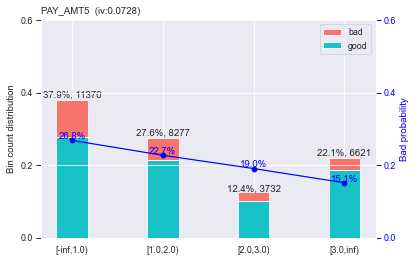

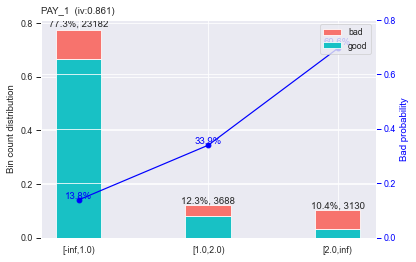

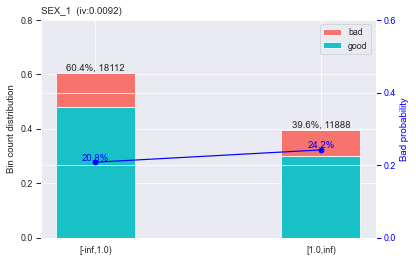

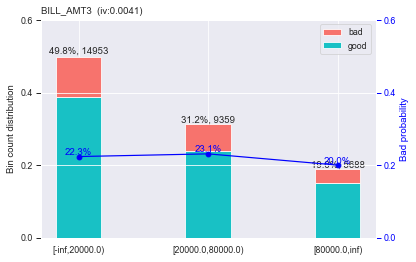

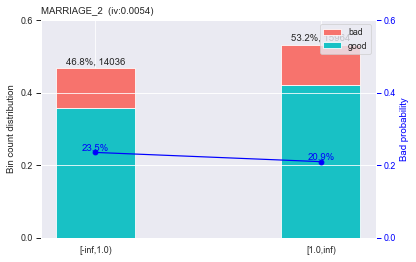

...

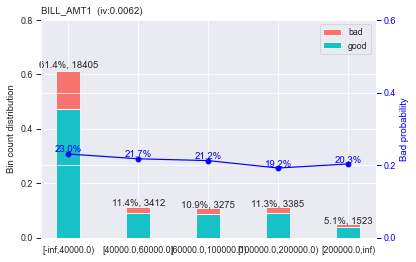

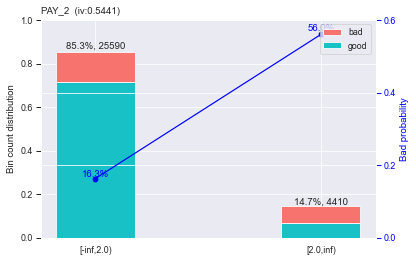

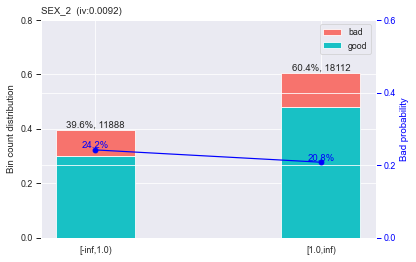

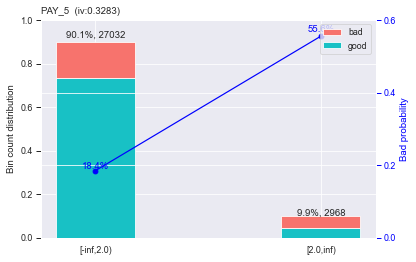

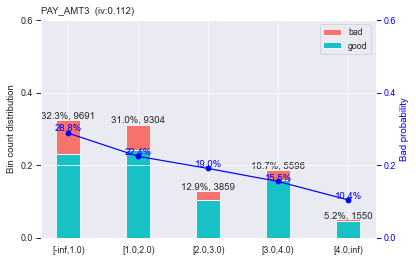

In [75]:
# for normal sampling

bins = sc.woebin(df, y='default', 
                 min_perc_fine_bin = 0.05,     # How many bins to cut initially into
                 min_perc_coarse_bin = 0.05,   # Minimum percentage per final bin
                 stop_limit = 0.1,             # Minimum information value 
                 max_num_bin = 8,              # Maximum number of bins
                 method = 'tree')

sc.woebin_plot(bins)

We could set our threshold to be 0.1 that is any iv value less than 0.1 would be dropped

[INFO] creating woe binning ...
Binning on 32710 rows and 30 columns in 00:00:16


{'PAY_AMT5': <Figure size 432x288 with 2 Axes>,
 'PAY_1': <Figure size 432x288 with 2 Axes>,
 'SEX_1': <Figure size 432x288 with 2 Axes>,
 'BILL_AMT3': <Figure size 432x288 with 2 Axes>,
 'MARRIAGE_2': <Figure size 432x288 with 2 Axes>,
 'EDUCATION_1': <Figure size 432x288 with 2 Axes>,
 'AGE': <Figure size 432x288 with 2 Axes>,
 'PAY_AMT2': <Figure size 432x288 with 2 Axes>,
 'PAY_4': <Figure size 432x288 with 2 Axes>,
 'PAY_AMT6': <Figure size 432x288 with 2 Axes>,
 'EDUCATION_2': <Figure size 432x288 with 2 Axes>,
 'BILL_AMT2': <Figure size 432x288 with 2 Axes>,
 'PAY_AMT1': <Figure size 432x288 with 2 Axes>,
 'BILL_AMT6': <Figure size 432x288 with 2 Axes>,
 'PAY_AMT4': <Figure size 432x288 with 2 Axes>,
 'MARRIAGE_3': <Figure size 432x288 with 2 Axes>,
 'MARRIAGE_1': <Figure size 432x288 with 2 Axes>,
 'PAY_3': <Figure size 432x288 with 2 Axes>,
 'EDUCATION_3': <Figure size 432x288 with 2 Axes>,
 'PAY_6': <Figure size 432x288 with 2 Axes>,
 'BILL_AMT5': <Figure size 432x288 with 2 

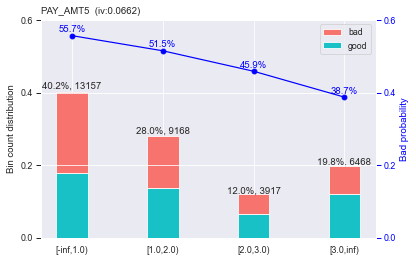

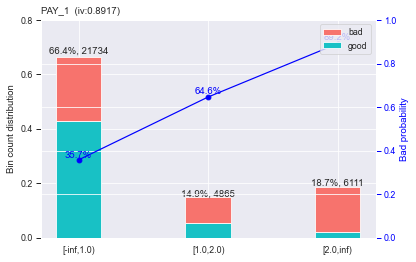

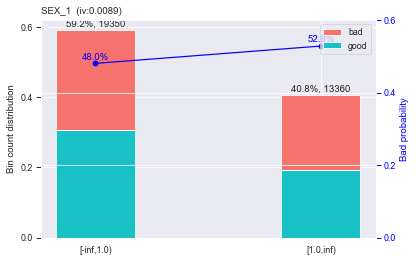

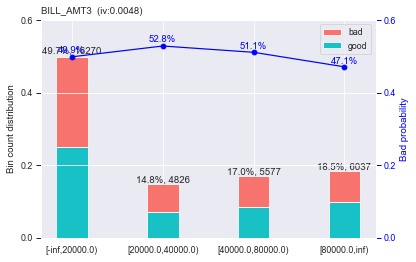

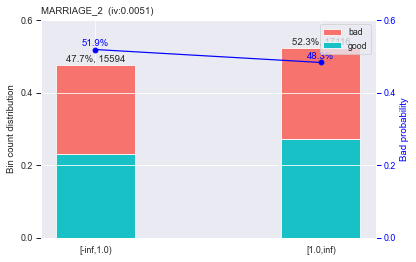

...

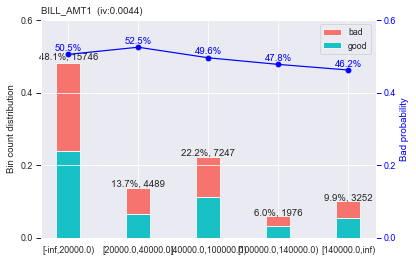

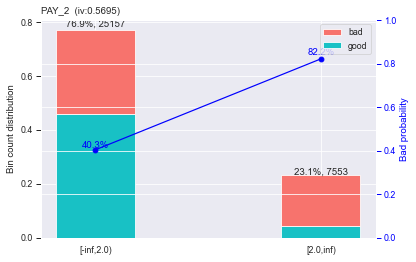

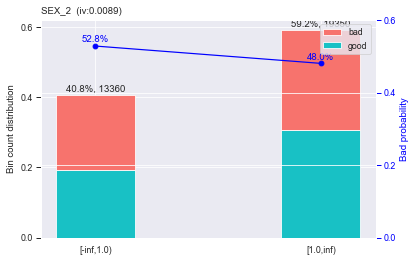

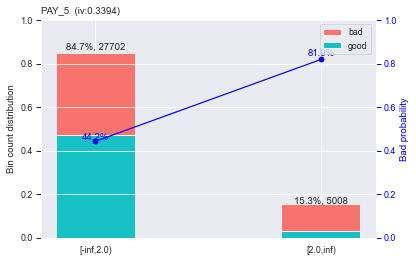

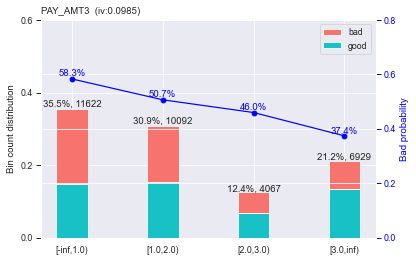

In [76]:
# for upsampling

bins = sc.woebin(df_upsampled, y='default', 
                 min_perc_fine_bin = 0.05,     # How many bins to cut initially into
                 min_perc_coarse_bin = 0.05,   # Minimum percentage per final bin
                 stop_limit = 0.1,             # Minimum information value 
                 max_num_bin = 8,              # Maximum number of bins
                 method = 'tree')

sc.woebin_plot(bins)

[INFO] creating woe binning ...
Binning on 9290 rows and 30 columns in 00:00:13


{'PAY_AMT5': <Figure size 432x288 with 2 Axes>,
 'PAY_1': <Figure size 432x288 with 2 Axes>,
 'SEX_1': <Figure size 432x288 with 2 Axes>,
 'BILL_AMT3': <Figure size 432x288 with 2 Axes>,
 'MARRIAGE_2': <Figure size 432x288 with 2 Axes>,
 'EDUCATION_1': <Figure size 432x288 with 2 Axes>,
 'AGE': <Figure size 432x288 with 2 Axes>,
 'PAY_AMT2': <Figure size 432x288 with 2 Axes>,
 'PAY_4': <Figure size 432x288 with 2 Axes>,
 'PAY_AMT6': <Figure size 432x288 with 2 Axes>,
 'EDUCATION_2': <Figure size 432x288 with 2 Axes>,
 'BILL_AMT2': <Figure size 432x288 with 2 Axes>,
 'PAY_AMT1': <Figure size 432x288 with 2 Axes>,
 'BILL_AMT6': <Figure size 432x288 with 2 Axes>,
 'PAY_AMT4': <Figure size 432x288 with 2 Axes>,
 'MARRIAGE_3': <Figure size 432x288 with 2 Axes>,
 'MARRIAGE_1': <Figure size 432x288 with 2 Axes>,
 'PAY_3': <Figure size 432x288 with 2 Axes>,
 'EDUCATION_3': <Figure size 432x288 with 2 Axes>,
 'PAY_6': <Figure size 432x288 with 2 Axes>,
 'BILL_AMT5': <Figure size 432x288 with 2 

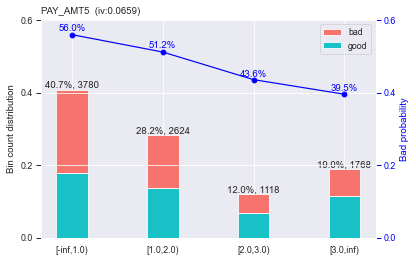

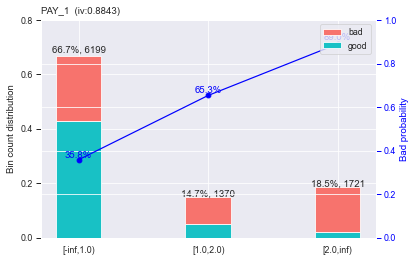

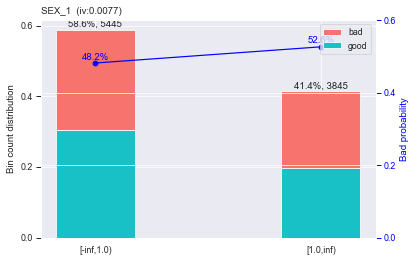

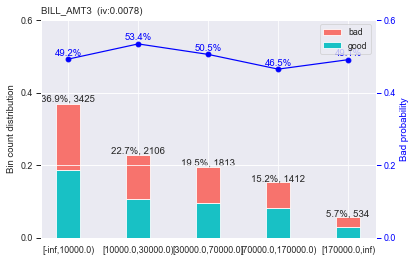

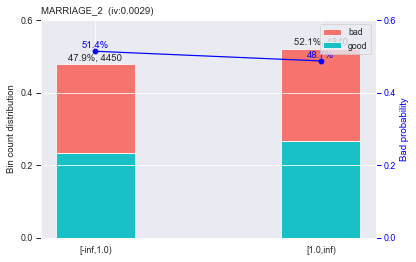

...

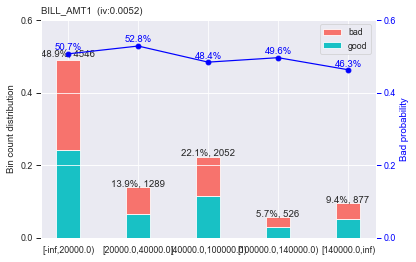

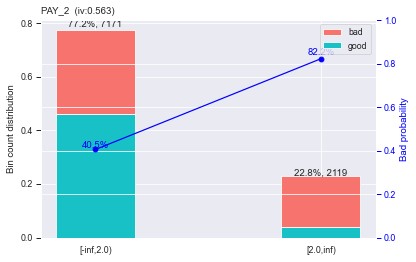

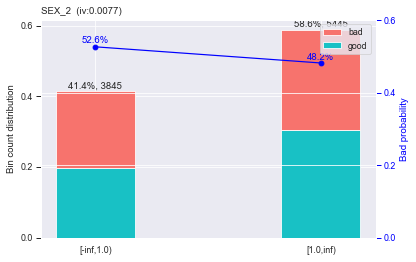

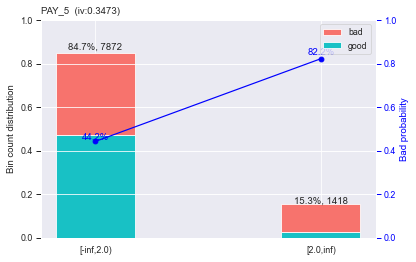

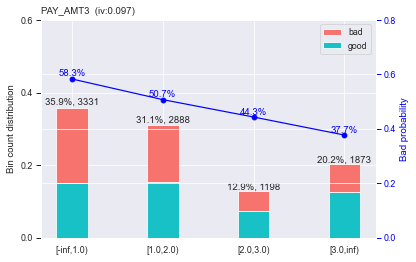

In [77]:
# for downsampling

bins = sc.woebin(df_downsampled, y='default', 
                 min_perc_fine_bin = 0.05,     # How many bins to cut initially into
                 min_perc_coarse_bin = 0.05,   # Minimum percentage per final bin
                 stop_limit = 0.1,             # Minimum information value 
                 max_num_bin = 8,              # Maximum number of bins
                 method = 'tree')

sc.woebin_plot(bins)

However, we did not make use of scorecardpy for feature selection, we made use of the rfecv


From the classifers above, Random forest performed the best on the data that had a reduction in the variance between its datapoints so we worked further with that set of data and the random forest classifier 

Using RFECV for Feature Selection:

In [78]:
xtrain_data = [X_train,df_upsampled.drop('default',axis = 1),df_downsampled.drop('default',axis = 1),X_SMOTE]
ytrain_data = [y_train,df_upsampled['default'],df_downsampled['default'],y_SMOTE]
name = ['Normal Sampling' , 'Over Sampling' , 'Under Sampling' , 'SMOTE']

for i,j,k in zip(xtrain_data,ytrain_data,name):
    # create pipeline
    rfe = RFECV(estimator=RandomForestClassifier())
    model = RandomForestClassifier()
    pipeline = Pipeline(steps=[('s',rfe),('m',model)])
    # evaluate model
    cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)
    n_scores = cross_val_score(pipeline, i, j, scoring='accuracy', cv=cv, n_jobs=-1, error_score='raise')
    # report performance
    print('Accuracy for',k,'using the Randomforestclassifier: %.3f' % (np.mean(n_scores)))
    rfe.fit(i,j)
    # summarize all features
    for y in range(i.shape[1]):
        print('Column for: %d, Selected %s, Rank: %.3f' % (y, rfe.support_[y], rfe.ranking_[y]))

Accuracy for Normal Sampling using the Randomforestclassifier: 0.804
Column for: 0, Selected True, Rank: 1.000
Column for: 1, Selected True, Rank: 1.000
Column for: 2, Selected True, Rank: 1.000
Column for: 3, Selected True, Rank: 1.000
Column for: 4, Selected True, Rank: 1.000
Column for: 5, Selected False, Rank: 3.000
Column for: 6, Selected False, Rank: 8.000
Column for: 7, Selected False, Rank: 4.000
Column for: 8, Selected True, Rank: 1.000
Column for: 9, Selected True, Rank: 1.000
Column for: 10, Selected True, Rank: 1.000
Column for: 11, Selected True, Rank: 1.000
Column for: 12, Selected True, Rank: 1.000
Column for: 13, Selected True, Rank: 1.000
Column for: 14, Selected False, Rank: 2.000
Column for: 15, Selected True, Rank: 1.000
Column for: 16, Selected True, Rank: 1.000
Column for: 17, Selected True, Rank: 1.000
Column for: 18, Selected True, Rank: 1.000
Column for: 19, Selected True, Rank: 1.000
Column for: 20, Selected True, Rank: 1.000
Column for: 21, Selected False, Ra

Dropping features for random forest classifier for the four datasets

First we drop the unselected features for the train set for all the four datasets

Next we recreate the test dataset by rejoining X_test and y_test, then drop the unslected features likewise for the four datasets

We the evaluate the performance of the Random forest classifier on the four datsets

Dropping features for the four datasets (training set):

In [79]:
# Normal sampling dataset


df_train = df_train.drop(df_train.iloc[:,[5,6,7,14,18,20,21,22,23,24,25,26,27,28]], axis=1)


In [80]:
# Random Oversampling dataset

df_upsampled = df_upsampled.drop(df_upsampled.iloc[:,[25,28]], axis=1)

In [81]:
# Random Undersampling dataset

df_downsampled = df_downsampled.drop(df_downsampled.iloc[:,[4,6,20,22,23,24,25,26,27,28]], axis=1)

In [82]:
# SMOTE

X_SMOTE = X_SMOTE.drop(X_SMOTE.iloc[:,[4,7,18,24,25,28]], axis=1)

In [83]:
X_SMOTE

,LIMIT_BAL,AGE,PAY_1,PAY_2,PAY_4,PAY_5,BILL_AMT1,BILL_AMT2,BILL_AMT3,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT6,SEX_1,SEX_2,EDUCATION_1,EDUCATION_2,MARRIAGE_1,MARRIAGE_2
0,2.0,32.000000,0.000000,0.000000,0.000000,0.000000,156098.000000,156259.000000,155404.000000,153234.000000,156731.000000,155818.000000,2.000000,3.000000,3.000000,3.000000,3.000000,0.000000,1.000000,0.0,1.000000,0.000000,1.000000
1,1.0,30.000000,0.000000,0.000000,0.000000,2.000000,28383.000000,32903.000000,42283.000000,51539.000000,50583.000000,52588.000000,2.000000,3.000000,3.000000,0.000000,1.000000,0.000000,1.000000,1.0,0.000000,0.000000,1.000000
2,1.0,29.000000,0.000000,0.000000,0.000000,0.000000,73722.000000,75323.000000,64277.000000,45455.000000,42231.000000,42804.000000,1.000000,2.000000,1.000000,1.000000,1.000000,1.000000,0.000000,1.0,0.000000,0.000000,1.000000
3,0.0,27.000000,0.000000,0.000000,0.000000,0.000000,7286.000000,2160.000000,780.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.0,1.000000,1.000000,0.000000
4,1.0,30.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2070.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,1.0,0.000000,0.000000,1.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32705,1.0,28.232846,1.616423,1.616423,1.616423,2.424634,81678.664770,83378.037763,85828.477542,89824.293562,91605.922446,87675.860843,1.191789,2.808211,2.808211,2.383577,1.808211,0.808211,0.191789,0.0,1.000000,0.808211,0.191789
32706,1.0,28.688363,2.000000,0.000000,0.000000,1.801369,16537.136910,17906.670969,20328.856021,22672.160813,23583.010436,23066.825496,1.000000,2.000000,2.000000,1.099315,1.000000,0.099315,0.900685,0.0,1.000000,0.099315,0.900685
32707,1.0,61.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.0,0.315861,0.000000,1.000000
32708,1.0,31.153084,0.895174,2.685522,1.790348,1.790348,47473.752917,46709.300126,47530.417709,48346.019471,49323.027780,50252.202602,0.209652,2.104826,1.104826,1.104826,1.000000,0.000000,1.000000,0.0,0.895174,0.104826,0.895174


 create the Testing dataframe by remerging X_test and y_test and dropping the unnecessary features for the four datasets

In [84]:
# Normal sampling dataset

df_test = X_test.join(y_test)
df_test


,LIMIT_BAL,AGE,PAY_1,PAY_2,PAY_3,PAY_4,PAY_5,PAY_6,BILL_AMT1,BILL_AMT2,BILL_AMT3,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,SEX_1,SEX_2,EDUCATION_1,EDUCATION_2,EDUCATION_3,EDUCATION_4,MARRIAGE_1,MARRIAGE_2,MARRIAGE_3,default
8941,2,30,0,0,0,0,0,0,101832.0,92396.0,84297.0,49681.0,46224.0,44800.0,2,2,1,2,1,1,1,0,0,1,0,0,0,1,0,0
17618,1,32,0,3,2,0,0,0,4927.0,4693.0,3342.0,4844.0,3728.0,2612.0,0,0,2,0,0,0,0,1,1,0,0,0,1,0,0,1
27895,1,29,0,0,0,0,0,0,167410.0,85536.0,77303.0,60178.0,56436.0,51773.0,3,2,1,1,1,3,0,1,1,0,0,0,0,1,0,0
16103,0,37,0,4,3,2,2,2,3305.0,2870.0,2440.0,2510.0,2641.0,2222.0,0,0,0,0,0,0,0,1,0,1,0,0,1,0,0,0
4422,1,34,0,0,0,0,0,0,24147.0,25750.0,27012.0,27762.0,32126.0,37779.0,1,2,1,3,3,0,0,1,0,1,0,0,1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
27933,2,25,0,0,0,0,0,0,177607.0,177498.0,176081.0,175540.0,142015.0,139162.0,2,3,3,3,3,3,0,1,0,1,0,0,0,1,0,0
26623,1,25,0,0,0,0,0,0,11669.0,12665.0,12905.0,13498.0,13993.0,13854.0,1,1,1,1,1,1,1,0,0,1,0,0,0,1,0,0
21750,1,24,0,0,0,0,0,0,6071.0,0.0,3308.0,2527.0,1076.0,1164.0,0,2,1,1,1,1,0,1,0,1,0,0,0,1,0,0
14888,3,37,1,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,1,0


In [85]:
# We have observed that there is imbalance in the samples from the countplot of the default column above.
# Let's see the distribution of the samples in the TEST dataset

# Separate majority and minority classes
df_majtest = df_test[df_test.default == 0]
df_mintest = df_test[df_test.default == 1]

print(df_test.default.value_counts())

0    7009
1    1991
Name: default, dtype: int64


In [86]:
# Random Oversampling dataset


# Upsample minority class
df_mintest_upsampled = resample(df_mintest, 
                                 replace=True,     # sample with replacement
                                 n_samples = 16355,    # to match majority class
                                 random_state= 42) # reproducible results
# Combine majority class with upsampled minority class
df_upsamptest = pd.concat([df_majtest, df_mintest_upsampled])
# Display new class counts
df_upsamptest.default.value_counts()


1    16355
0     7009
Name: default, dtype: int64

In [87]:
# Random Undersampling dataset


# Random Undersampling
    
# Downsample majority class
df_majtest_downsampled = resample(df_majtest, 
                                 replace=False,    # sample without replacement
                                 n_samples=4645,     # to match minority class
                                 random_state=587) # reproducible results
# Combine minority class with downsampled majority class
df_downsamptest = pd.concat([df_majtest_downsampled, df_mintest])
# Display new class counts
df_downsamptest.default.value_counts()


0    4645
1    1991
Name: default, dtype: int64

In [88]:
# SMOTE


X_SMOTE_test,y_SMOTE_test = SMOTE(random_state=42).fit_sample(X_test,y_test)
X_SMOTE_test_f = pd.DataFrame(data=X_SMOTE_test,columns= list(X_test.columns), dtype=None, copy=False)
y_SMOTE_test_f = pd.Series(y_SMOTE_test)



In [89]:
X_SMOTE_test_f

,LIMIT_BAL,AGE,PAY_1,PAY_2,PAY_3,PAY_4,PAY_5,PAY_6,BILL_AMT1,BILL_AMT2,BILL_AMT3,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,SEX_1,SEX_2,EDUCATION_1,EDUCATION_2,EDUCATION_3,EDUCATION_4,MARRIAGE_1,MARRIAGE_2,MARRIAGE_3
0,2.000000,30.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,101832.000000,92396.000000,84297.000000,49681.000000,46224.000000,44800.000000,2.000000,2.000000,1.000000,2.000000,1.000000,1.000000,1.000000,0.000000,0.000000,1.000000,0.000000,0.0,0.000000,1.000000,0.0
1,1.000000,32.000000,0.000000,3.000000,2.000000,0.000000,0.000000,0.0,4927.000000,4693.000000,3342.000000,4844.000000,3728.000000,2612.000000,0.000000,0.000000,2.000000,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000,0.000000,0.000000,0.0,1.000000,0.000000,0.0
2,1.000000,29.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,167410.000000,85536.000000,77303.000000,60178.000000,56436.000000,51773.000000,3.000000,2.000000,1.000000,1.000000,1.000000,3.000000,0.000000,1.000000,1.000000,0.000000,0.000000,0.0,0.000000,1.000000,0.0
3,0.000000,37.000000,0.000000,4.000000,3.000000,2.000000,2.000000,2.0,3305.000000,2870.000000,2440.000000,2510.000000,2641.000000,2222.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,1.000000,0.000000,0.0,1.000000,0.000000,0.0
4,1.000000,34.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,24147.000000,25750.000000,27012.000000,27762.000000,32126.000000,37779.000000,1.000000,2.000000,1.000000,3.000000,3.000000,0.000000,0.000000,1.000000,0.000000,1.000000,0.000000,0.0,1.000000,0.000000,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14013,1.894313,50.105687,0.368562,0.737125,0.737125,0.000000,0.000000,0.0,4811.554415,2396.343931,444.532022,2055.390507,1984.256154,4325.011652,0.631438,0.000000,1.000000,1.368562,2.262875,1.894313,0.368562,0.631438,0.000000,0.631438,0.368562,0.0,1.000000,0.000000,0.0
14014,0.000000,22.039988,4.800059,3.840048,2.960012,1.920024,1.920024,2.0,8514.807782,8302.590317,7986.562507,7753.070175,8251.311885,7900.013069,0.039988,0.039988,0.039988,0.000000,0.000000,0.000000,0.039988,0.960012,0.000000,1.000000,0.000000,0.0,0.000000,1.000000,0.0
14015,1.000000,42.563690,0.820461,1.640923,2.000000,2.000000,2.000000,2.0,24509.788306,26951.242703,27868.300797,27125.634800,28627.703035,28028.703035,1.000000,0.820461,0.000000,2.000000,0.000000,0.820461,0.000000,1.000000,0.000000,0.820461,0.179539,0.0,1.000000,0.000000,0.0
14016,2.853948,34.415794,2.000000,1.707897,0.000000,0.000000,0.000000,0.0,922.009892,56.960099,56.960099,6592.673318,3934.740481,113.920199,0.000000,0.000000,2.853948,0.438155,0.000000,0.000000,0.000000,1.000000,1.000000,0.000000,0.000000,0.0,0.853948,0.146052,0.0


Dropping unnecessary features in the four new datasets

In [90]:
# Normal sampling dataset

df_test = df_test.drop(df_test.iloc[:,[5,6,7,14,18,20,21,22,23,24,25,26,27,28]], axis=1)

In [91]:
# Random Oversampling

df_upsamptest = df_upsamptest.drop(df_upsamptest.iloc[:,[25,28]], axis=1)

In [92]:
# Random Undersampling

df_downsamptest = df_downsamptest.drop(df_downsamptest.iloc[:,[4,6,20,22,23,24,25,26,27,28]], axis=1)

In [93]:
# SMOTE

X_SMOTE_test_f = X_SMOTE_test_f.drop(X_SMOTE_test_f.iloc[:,[4,7,18,24,25,28]], axis=1)

In [94]:
X_SMOTE_test_f

,LIMIT_BAL,AGE,PAY_1,PAY_2,PAY_4,PAY_5,BILL_AMT1,BILL_AMT2,BILL_AMT3,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT6,SEX_1,SEX_2,EDUCATION_1,EDUCATION_2,MARRIAGE_1,MARRIAGE_2
0,2.000000,30.000000,0.000000,0.000000,0.000000,0.000000,101832.000000,92396.000000,84297.000000,49681.000000,46224.000000,44800.000000,2.000000,2.000000,1.000000,2.000000,1.000000,1.000000,0.000000,0.000000,1.000000,0.000000,1.000000
1,1.000000,32.000000,0.000000,3.000000,0.000000,0.000000,4927.000000,4693.000000,3342.000000,4844.000000,3728.000000,2612.000000,0.000000,0.000000,2.000000,0.000000,0.000000,0.000000,1.000000,1.000000,0.000000,1.000000,0.000000
2,1.000000,29.000000,0.000000,0.000000,0.000000,0.000000,167410.000000,85536.000000,77303.000000,60178.000000,56436.000000,51773.000000,3.000000,2.000000,1.000000,1.000000,3.000000,0.000000,1.000000,1.000000,0.000000,0.000000,1.000000
3,0.000000,37.000000,0.000000,4.000000,2.000000,2.000000,3305.000000,2870.000000,2440.000000,2510.000000,2641.000000,2222.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,1.000000,1.000000,0.000000
4,1.000000,34.000000,0.000000,0.000000,0.000000,0.000000,24147.000000,25750.000000,27012.000000,27762.000000,32126.000000,37779.000000,1.000000,2.000000,1.000000,3.000000,0.000000,0.000000,1.000000,0.000000,1.000000,1.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14013,1.894313,50.105687,0.368562,0.737125,0.000000,0.000000,4811.554415,2396.343931,444.532022,2055.390507,1984.256154,4325.011652,0.631438,0.000000,1.000000,1.368562,1.894313,0.368562,0.631438,0.000000,0.631438,1.000000,0.000000
14014,0.000000,22.039988,4.800059,3.840048,1.920024,1.920024,8514.807782,8302.590317,7986.562507,7753.070175,8251.311885,7900.013069,0.039988,0.039988,0.039988,0.000000,0.000000,0.039988,0.960012,0.000000,1.000000,0.000000,1.000000
14015,1.000000,42.563690,0.820461,1.640923,2.000000,2.000000,24509.788306,26951.242703,27868.300797,27125.634800,28627.703035,28028.703035,1.000000,0.820461,0.000000,2.000000,0.820461,0.000000,1.000000,0.000000,0.820461,1.000000,0.000000
14016,2.853948,34.415794,2.000000,1.707897,0.000000,0.000000,922.009892,56.960099,56.960099,6592.673318,3934.740481,113.920199,0.000000,0.000000,2.853948,0.438155,0.000000,0.000000,1.000000,1.000000,0.000000,0.853948,0.146052


Evaluating the performance of the Random forest classifier on these datasets

In [95]:

xtrain_data = [df_train.drop('default',axis = 1),df_upsampled.drop('default',axis = 1),df_downsampled.drop('default',axis = 1),X_SMOTE]
ytrain_data = [df_train['default'],df_upsampled['default'],df_downsampled['default'],y_SMOTE]
x_test_data = [df_test.drop('default',axis = 1),df_upsamptest.drop('default',axis = 1),df_downsamptest.drop('default',axis = 1),X_SMOTE_test_f]    
y_test_data = [df_test['default'],df_upsamptest['default'],df_downsamptest['default'],y_SMOTE_test_f]
name = ['Normal Sampling' , 'Over Sampling' , 'Under Sampling', 'Smote']

p = [xtrain_data,ytrain_data,x_test_data,y_test_data,name]


for i,j,x,y,n in zip(*p):
    print('Data is: ',n)
    model_eval(RandomForestClassifier(random_state= 42), i,j,x,y)
    print("_" * 60)

Data is:  Normal Sampling
Overall Train Accuracy 0.9732857142857143
Train AUC Score 0.9974712242728035
Overall Test Accuracy 0.8013333333333333
Test AUC Score 0.7137897038313158
Classification Report of Test
               precision    recall  f1-score   support

           0       0.83      0.94      0.88      7009
           1       0.59      0.32      0.42      1991

    accuracy                           0.80      9000
   macro avg       0.71      0.63      0.65      9000
weighted avg       0.78      0.80      0.78      9000

K-Fold scores: 0.632 (+/- 0.00003)
____________________________________________________________
Data is:  Over Sampling
Overall Train Accuracy 0.9949250993579944
Train AUC Score 0.9997764537418357
Overall Test Accuracy 0.5373223763054271
Test AUC Score 0.7211773141044712
Classification Report of Test
               precision    recall  f1-score   support

           0       0.39      0.91      0.54      7009
           1       0.91      0.38      0.53     1635

Now we would view the performances of all the classifers on all the datasets (The dataset with variance reduction and without)

Result for No Hyper Parameter Tuning, No Feature Engineering


In [19]:
dp = pd.read_excel('C:\\Users\\MOFEOLUWA\\Desktop\\AI sat project excel.xlsx','Sheet1')

score_d = pd.DataFrame(dp)
fig =  ff.create_table(score_d)
fig.show()

Result for the  Training Dataset with no Variance and with Variance (Logistic Regression) 


In [21]:
dp = pd.read_excel('C:\\Users\\MOFEOLUWA\\Desktop\\AI sat project excel.xlsx','Sheet2')

score_dp = pd.DataFrame(dp)
fig =  ff.create_table(score_dp)
fig.show()

Result for the  Training Dataset with no Variance and with Variance (Random Forest Classifier) 


In [22]:
dp = pd.read_excel('C:\\Users\\MOFEOLUWA\\Desktop\\AI sat project excel.xlsx','Sheet3')

score_dp = pd.DataFrame(dp)
fig =  ff.create_table(score_dp)
fig.show()

Result for the  Training Dataset with no Variance and with Variance (XGBoost Classifier) 


In [23]:
dp = pd.read_excel('C:\\Users\\MOFEOLUWA\\Desktop\\AI sat project excel.xlsx','Sheet4')

score_dp = pd.DataFrame(dp)
fig =  ff.create_table(score_dp)
fig.show()

Result for the  Training Dataset with no Variance and with Variance (CATBoost Classifier) 

In [24]:
dp = pd.read_excel('C:\\Users\\MOFEOLUWA\\Desktop\\AI sat project excel.xlsx','Sheet5')

score_dp = pd.DataFrame(dp)
fig =  ff.create_table(score_dp)
fig.show()

Results  for the  Training Dataset with no Variance and with Variance (Random Forest Classifier) and the result after Feature Selection.


In [25]:
dp = pd.read_excel('C:\\Users\\MOFEOLUWA\\Desktop\\AI sat project excel.xlsx','Sheet6')

score_dp = pd.DataFrame(dp)
fig =  ff.create_table(score_dp)
fig.show()

# CONCLUSION

From the results above, based on our basis for selecting the best classifier as earlier stated, Random forest Classifier, perfromed the best on the SMOTE dataset with a reduction in variance between data points and the dropping of unncessary features using the RFECV function.

The Overall accuracy score was 0.858

The Test AUC score: 0.904

With a high recall score (for class 1) of 0.78

As seen in the table above.

This would make our clients (The credit card company in Taiwan) happy and confident in our model to give the best result they require which is to predict if a customer defaults in credit card loan repayment or not.

The model built can without doubt give the best result.

### Acknowledgement 

 We would love to acknowledge the help of chizirum, Tejumade, Kenny and other Ai saturday team members who helped in the finalizing of this project. Your help and support has been so invaluable for the fruition of this project
 
From Oluwanifesimi Ademoye and Mofeoluwa Opadotun 

### Reference 
##### This blog helped in the featture selection for RFECV Selection 
https://machinelearningmastery.com/rfe-feature-selection-in-python/
###### This  helped also in feature selection using score.py
https://pypi.org/project/scorecardpy/  


